# SVC 

As outlined in the EBC_optimization notebook, at least one other classifier should be tested for its performance on the dataset.
Thus, a support vector machine (SVM) classifier was chosen as SVMs in general are praised oftentimes for their performance abilities thanks to their abundance of parameters that can be tweaked according to the dataset.


Unfortunately, using SVMs is way more inconvenient as using EBMs as features have to be one-hot encoded and interaction terms have to be added manually. 




In [1]:
import pandas as pd
import holidays
import itertools
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_transformer
import matplotlib.pyplot as plt
from sktime.performance_metrics.forecasting import make_forecasting_scorer
import numpy as np
from imblearn.over_sampling import SMOTE, ADASYN, BorderlineSMOTE, RandomOverSampler

pd.set_option('display.max_columns', None)

%matplotlib inline

data = pd.read_csv("sickness_table.csv")
data.drop(data.columns[0], axis = 1, inplace = True)

data["date"] = pd.to_datetime(data["date"])
#data.set_index("date", inplace = True)

data["sby_required"] = data["sby_need"] > 0
data["day_of_month"] = data["date"].dt.day
data["weekday"] = data["date"].dt.day_of_week
data["weekday_name"] = data["date"].dt.day_name()
data["month"] = data["date"].dt.month
data["month_name"] = data["date"].dt.month_name()
data["year"] = data["date"].dt.year
data["is_weekend"] = (data["weekday_name"] == "Saturday") | (data["weekday_name"] == "Sunday")

# create column indicating public holidays
holidays_berlin = holidays.DE(subdiv = "BE", years = [2016, 2017, 2018, 2019])

#initiate column
data["is_holiday"] = False

#set true if date is holiday
for index in range(len(data["date"])):
    if data.loc[index, "date"] in holidays_berlin:
        data.loc[index, "is_holiday"] = True

#crate column indicating school holidays
holidays_school = []
holidays_school.append(pd.date_range("2016-04-01", periods = 1)) #Osterferien
holidays_school.append(pd.date_range("2016-05-06", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2016-05-17", periods = 2)) #Pfingstferien
holidays_school.append(pd.date_range("2016-07-21", periods = 2)) #Sommerferien
holidays_school.append(pd.date_range("2016-07-25", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-01", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-01", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-08", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-15", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-22", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-29", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-10-17", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2016-10-24", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2016-12-23", periods = 1)) #Weihnachtsferien
holidays_school.append(pd.date_range("2016-12-27", periods = 4)) #Weihnachtsferien
holidays_school.append(pd.date_range("2017-01-02", periods = 2)) #Weihnachtsferien
holidays_school.append(pd.date_range("2017-01-30", periods = 5)) #Winterferien
holidays_school.append(pd.date_range("2017-04-10", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2017-04-18", periods = 1)) #Osterferien
holidays_school.append(pd.date_range("2017-05-24", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2017-05-26", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2017-06-06", periods = 4)) #Pfingstferien
holidays_school.append(pd.date_range("2017-07-20", periods = 1)) #Sommerferien
holidays_school.append(pd.date_range("2017-07-24", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-07-31", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-01", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-07", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-14", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-21", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-28", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-10-02", periods = 1)) #Herbstferien
holidays_school.append(pd.date_range("2017-10-23", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2017-10-30", periods = 1)) #Herbstferien
holidays_school.append(pd.date_range("2017-11-01", periods = 3)) #Herbstferien
holidays_school.append(pd.date_range("2017-12-21", periods = 2)) #Weihnachtsferien
holidays_school.append(pd.date_range("2017-12-27", periods = 3)) #Weihnachtsferien
holidays_school.append(pd.date_range("2018-01-02", periods = 1)) #Weihnachtsferien
holidays_school.append(pd.date_range("2018-02-05", periods = 5)) #Winterferien
holidays_school.append(pd.date_range("2018-03-26", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2018-04-06", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2018-04-30", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2018-05-11", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2018-05-22", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2018-07-05", periods = 2)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-09", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-16", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-23", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-30", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-08-06", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-08-13", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-10-22", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2018-10-29", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2018-12-24", periods = 1)) #Weihnachtsferien
holidays_school.append(pd.date_range("2018-12-31", periods = 5)) #Weihnachtsferien
holidays_school.append(pd.date_range("2019-02-04", periods = 5)) #Winterferien
holidays_school.append(pd.date_range("2019-04-15", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2019-04-23", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2019-05-31", periods = 1)) #Osterferien

#flatten list
holidays_school = list(itertools.chain(*holidays_school))

data["is_school_holiday"] = False

#set true if date is holiday
for index in range(len(data["date"])):
    if data.loc[index, "date"] in holidays_school:
        data.loc[index, "is_school_holiday"] = True

data["kids_out_of_school"] = data["is_school_holiday"] | data["is_holiday"]

# quarter feature
data["quarter"] = 1
data.loc[(data["month"] > 3) & (data["month"] < 7), "quarter"] = 2
data.loc[(data["month"] > 6) & (data["month"] < 10), "quarter"] = 3
data.loc[data["month"] > 9, "quarter"] = 4

# season feature
data["season"] = "winter"
data.loc[(data["month"] >= 3) & (data["month"] <= 5), "season"] = "spring"
data.loc[(data["month"] >= 6) & (data["month"] <= 8), "season"] = "summer"
data.loc[(data["month"] >= 9) & (data["month"] <= 11), "season"] = "fall"


# week of the month count feature
data["week_num"] = 1
data.loc[(data["day_of_month"] > 7) & (data["day_of_month"] < 15), "week_num"] = 2
data.loc[(data["day_of_month"] > 14) & (data["day_of_month"] < 22), "week_num"] = 3
data.loc[(data["day_of_month"] > 21) & (data["day_of_month"] < 29), "week_num"] = 4
data.loc[data["day_of_month"] > 28, "week_num"] = 5

#print(data["day_of_month"].dtype)

#add the "unique_id" column for statsforecast regressors
data["unique_id"] = "sby_need"

# rename for statsforecast input df format
data.rename({"date": "ds", "sby_need": "y"}, axis = 1, inplace=True)

data



,ds,n_sick,calls,n_duty,n_sby,y,dafted,sby_required,day_of_month,weekday,weekday_name,month,month_name,year,is_weekend,is_holiday,is_school_holiday,kids_out_of_school,quarter,season,week_num,unique_id
0,2016-04-01,73,8154.0,1700,90,4.0,0.0,True,1,4,Friday,4,April,2016,False,False,True,True,2,spring,1,sby_need
1,2016-04-02,64,8526.0,1700,90,70.0,0.0,True,2,5,Saturday,4,April,2016,True,False,False,False,2,spring,1,sby_need
2,2016-04-03,68,8088.0,1700,90,0.0,0.0,False,3,6,Sunday,4,April,2016,True,False,False,False,2,spring,1,sby_need
3,2016-04-04,71,7044.0,1700,90,0.0,0.0,False,4,0,Monday,4,April,2016,False,False,False,False,2,spring,1,sby_need
4,2016-04-05,63,7236.0,1700,90,0.0,0.0,False,5,1,Tuesday,4,April,2016,False,False,False,False,2,spring,1,sby_need
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1147,2019-05-23,86,8544.0,1900,90,0.0,0.0,False,23,3,Thursday,5,May,2019,False,False,False,False,2,spring,4,sby_need
1148,2019-05-24,81,8814.0,1900,90,0.0,0.0,False,24,4,Friday,5,May,2019,False,False,False,False,2,spring,4,sby_need
1149,2019-05-25,76,9846.0,1900,90,146.0,56.0,True,25,5,Saturday,5,May,2019,True,False,False,False,2,spring,4,sby_need
1150,2019-05-26,83,9882.0,1900,90,160.0,70.0,True,26,6,Sunday,5,May,2019,True,False,False,False,2,spring,4,sby_need


### One-hot encoding 

In [19]:
transformer = make_column_transformer((OneHotEncoder(), ["season", "week_num", "month_name",
                                                          "weekday_name",]), 
                                      verbose_feature_names_out = False, 
                                      remainder='passthrough')
transformed = transformer.fit_transform(data)
transformed_df = pd.DataFrame(transformed, columns=transformer.get_feature_names_out())
print(transformed_df.columns)

# get rid of unnecessary stuff
reduced_classification_df = transformed_df.drop(columns = ['n_sick', 'calls', 'n_duty', 'n_sby',
                                                           "day_of_month", 'is_school_holiday','dafted',
                                                           "month", "weekday", "year", "quarter", 
                                                          "unique_id",])


reduced_classification_df.head()

Index(['season_fall', 'season_spring', 'season_summer', 'season_winter',
       'week_num_1', 'week_num_2', 'week_num_3', 'week_num_4', 'week_num_5',
       'month_name_April', 'month_name_August', 'month_name_December',
       'month_name_February', 'month_name_January', 'month_name_July',
       'month_name_June', 'month_name_March', 'month_name_May',
       'month_name_November', 'month_name_October', 'month_name_September',
       'weekday_name_Friday', 'weekday_name_Monday', 'weekday_name_Saturday',
       'weekday_name_Sunday', 'weekday_name_Thursday', 'weekday_name_Tuesday',
       'weekday_name_Wednesday', 'ds', 'n_sick', 'calls', 'n_duty', 'n_sby',
       'y', 'dafted', 'sby_required', 'day_of_month', 'weekday', 'month',
       'year', 'is_weekend', 'is_holiday', 'is_school_holiday',
       'kids_out_of_school', 'quarter', 'unique_id'],
      dtype='object')


,season_fall,season_spring,season_summer,season_winter,week_num_1,week_num_2,week_num_3,week_num_4,week_num_5,month_name_April,month_name_August,month_name_December,month_name_February,month_name_January,month_name_July,month_name_June,month_name_March,month_name_May,month_name_November,month_name_October,month_name_September,weekday_name_Friday,weekday_name_Monday,weekday_name_Saturday,weekday_name_Sunday,weekday_name_Thursday,weekday_name_Tuesday,weekday_name_Wednesday,ds,y,sby_required,is_weekend,is_holiday,kids_out_of_school
0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2016-04-01,4.0,True,False,False,True
1,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2016-04-02,70.0,True,True,False,False
2,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2016-04-03,0.0,False,True,False,False
3,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2016-04-04,0.0,False,False,False,False
4,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2016-04-05,0.0,False,False,False,False


### interaction terms

In the following, interaction terms are added.

Not all possible feature combinations are considered, however, as some of them may not make a lot of sense.

Also, the day of the month feature was not hot-encoded as this would lead to an explosion in the number of features, especially when considering interactions.
Instead, the number of week feature was created, where the number of the week in each month is specified, e.g., first week of the month, second week of the month, etc. 
Thereby, so I thought, information about where a day is located in a given month could still be retrieved.

The following interactions were added:

season * week number

month * week number

weekday * week number

month * weekday * week number



In [20]:
#add interactions
#https://stackoverflow.com/questions/70506177/mitigating-a-performance-warning-from-pandas-dataframe-is-highly-fragmented

season_columns = pd.DataFrame({f"season_{season}_week_num_{str(week_num)}": 
                               reduced_classification_df[f"season_{season}"] * 
                               reduced_classification_df[f"week_num_{str(week_num)}"] 
                               for season in data.season.unique()
                              for week_num in data.week_num.unique()})

month_columns = pd.DataFrame({f"month_name_{month}_week_num_{str(week_num)}": 
                              reduced_classification_df[f"month_name_{month}"] * 
                              reduced_classification_df[f"week_num_{str(week_num)}"] 
                              for month in data.month_name.unique() 
                              for week_num in data.week_num.unique()})        

weekday_columns = pd.DataFrame({f"weekday_name_{weekday}_week_num_{str(week_num)}": 
                              reduced_classification_df[f"weekday_name_{weekday}"] * 
                              reduced_classification_df[f"week_num_{str(week_num)}"] 
                              for weekday in data.weekday_name.unique() 
                              for week_num in data.week_num.unique()})  

triple_interactions = pd.DataFrame({f"month_name_{month}_weekday_name_{weekday}_week_num_{str(week_num)}": 
                              reduced_classification_df[f"month_name_{month}"] *
                              reduced_classification_df[f"weekday_name_{weekday}"] * 
                              reduced_classification_df[f"week_num_{str(week_num)}"] 
                              for month in data.month_name.unique()
                              for weekday in data.weekday_name.unique() 
                              for week_num in data.week_num.unique()})  
            
reduced_classification_df = pd.concat([reduced_classification_df, 
                                       season_columns,
                                      month_columns,
                                      weekday_columns,
                                      triple_interactions], axis = 1)   

# encode binary variables into integer
reduced_classification_df[["sby_required", "is_weekend", "is_holiday", "kids_out_of_school"]] = reduced_classification_df[["sby_required", "is_weekend", "is_holiday", "kids_out_of_school"]].astype("int")

print(len(reduced_classification_df.columns))
# https://stackoverflow.com/questions/14984119/python-pandas-remove-duplicate-columns
reduced_classification_df = reduced_classification_df.loc[:,~reduced_classification_df.columns.duplicated()].copy()
print(len(reduced_classification_df.columns))

reduced_classification_df.head()

569
569


,season_fall,season_spring,season_summer,season_winter,week_num_1,week_num_2,week_num_3,week_num_4,week_num_5,month_name_April,month_name_August,month_name_December,month_name_February,month_name_January,month_name_July,month_name_June,month_name_March,month_name_May,month_name_November,month_name_October,month_name_September,weekday_name_Friday,weekday_name_Monday,weekday_name_Saturday,weekday_name_Sunday,weekday_name_Thursday,weekday_name_Tuesday,weekday_name_Wednesday,ds,y,sby_required,is_weekend,is_holiday,kids_out_of_school,season_spring_week_num_1,season_spring_week_num_2,season_spring_week_num_3,season_spring_week_num_4,season_spring_week_num_5,season_summer_week_num_1,season_summer_week_num_2,season_summer_week_num_3,season_summer_week_num_4,season_summer_week_num_5,season_fall_week_num_1,season_fall_week_num_2,season_fall_week_num_3,season_fall_week_num_4,season_fall_week_num_5,season_winter_week_num_1,season_winter_week_num_2,season_winter_week_num_3,season_winter_week_num_4,season_winter_week_num_5,month_name_April_week_num_1,month_name_April_week_num_2,month_name_April_week_num_3,month_name_April_week_num_4,month_name_April_week_num_5,month_name_May_week_num_1,month_name_May_week_num_2,month_name_May_week_num_3,month_name_May_week_num_4,month_name_May_week_num_5,month_name_June_week_num_1,month_name_June_week_num_2,month_name_June_week_num_3,month_name_June_week_num_4,month_name_June_week_num_5,month_name_July_week_num_1,month_name_July_week_num_2,month_name_July_week_num_3,month_name_July_week_num_4,month_name_July_week_num_5,month_name_August_week_num_1,month_name_August_week_num_2,month_name_August_week_num_3,month_name_August_week_num_4,month_name_August_week_num_5,month_name_September_week_num_1,month_name_September_week_num_2,month_name_September_week_num_3,month_name_September_week_num_4,month_name_September_week_num_5,month_name_October_week_num_1,month_name_October_week_num_2,month_name_October_week_num_3,month_name_October_week_num_4,month_name_October_week_num_5,month_name_November_week_num_1,month_name_November_week_num_2,month_name_November_week_num_3,month_name_November_week_num_4,month_name_November_week_num_5,month_name_December_week_num_1,month_name_December_week_num_2,month_name_December_week_num_3,month_name_December_week_num_4,month_name_December_week_num_5,month_name_January_week_num_1,month_name_January_week_num_2,month_name_January_week_num_3,month_name_January_week_num_4,month_name_January_week_num_5,month_name_February_week_num_1,month_name_February_week_num_2,month_name_February_week_num_3,month_name_February_week_num_4,month_name_February_week_num_5,month_name_March_week_num_1,month_name_March_week_num_2,month_name_March_week_num_3,month_name_March_week_num_4,month_name_March_week_num_5,weekday_name_Friday_week_num_1,weekday_name_Friday_week_num_2,weekday_name_Friday_week_num_3,weekday_name_Friday_week_num_4,weekday_name_Friday_week_num_5,weekday_name_Saturday_week_num_1,weekday_name_Saturday_week_num_2,weekday_name_Saturday_week_num_3,weekday_name_Saturday_week_num_4,weekday_name_Saturday_week_num_5,weekday_name_Sunday_week_num_1,weekday_name_Sunday_week_num_2,weekday_name_Sunday_week_num_3,weekday_name_Sunday_week_num_4,weekday_name_Sunday_week_num_5,weekday_name_Monday_week_num_1,weekday_name_Monday_week_num_2,weekday_name_Monday_week_num_3,weekday_name_Monday_week_num_4,weekday_name_Monday_week_num_5,weekday_name_Tuesday_week_num_1,weekday_name_Tuesday_week_num_2,weekday_name_Tuesday_week_num_3,weekday_name_Tuesday_week_num_4,weekday_name_Tuesday_week_num_5,weekday_name_Wednesday_week_num_1,weekday_name_Wednesday_week_num_2,weekday_name_Wednesday_week_num_3,weekday_name_Wednesday_week_num_4,weekday_name_Wednesday_week_num_5,weekday_name_Thursday_week_num_1,weekday_name_Thursday_week_num_2,weekday_name_Thursday_week_num_3,weekday_name_Thursday_week_num_4,weekday_name_Thursday_week_num_5,month_name_April_weekday_name_Friday_week_num_1,month_name_April_weekday_name_Friday_week_num_2,mont

Now, there are 569 features already.

Which ones to keep?

First, feature importances were calculated using a random forest classifier.

season_fall = 0.005481351656473428
season_spring = 0.008108615249494149
season_summer = 0.014148180251082717
season_winter = 0.02961563309846035
week_num_1 = 0.025052247096457442
week_num_2 = 0.003842843935882728
week_num_3 = 0.004513064798504968
week_num_4 = 0.008797561807084263
week_num_5 = 0.004020376725784698
month_name_April = 0.007196748730482418
month_name_August = 0.008549360752093933
month_name_December = 0.007551450496479641
month_name_February = 0.004003638812068865
month_name_January = 0.008530971768497365
month_name_July = 0.00697446483882513
month_name_June = 0.006613262286160166
month_name_March = 0.005635521528388354
month_name_May = 0.009073670937240808
month_name_November = 0.008347458020138155
month_name_October = 0.005138086846990947
month_name_September = 0.01039380449300687
weekday_name_Friday = 0.01225849608360317
weekday_name_Monday = 0.013565361934545741
weekday_name_Saturday = 0.008477719254909762
weekday_name_Sunday = 0.013047987842348865
weekday_name_Thursda

month_name_July_weekday_name_Friday_week_num_3 = 0.000866430385504639
month_name_July_weekday_name_Friday_week_num_4 = 0.0007830985312980899
month_name_July_weekday_name_Friday_week_num_5 = 0.00012553905394473757
month_name_July_weekday_name_Saturday_week_num_1 = 0.0006608402531109868
month_name_July_weekday_name_Saturday_week_num_2 = 0.0017961523009755133
month_name_July_weekday_name_Saturday_week_num_3 = 0.0006083975823270904
month_name_July_weekday_name_Saturday_week_num_4 = 0.0002789011108489351
month_name_July_weekday_name_Saturday_week_num_5 = 3.681217567569765e-05
month_name_July_weekday_name_Sunday_week_num_1 = 0.0011553006790705304
month_name_July_weekday_name_Sunday_week_num_2 = 0.0005323011466868111
month_name_July_weekday_name_Sunday_week_num_3 = 0.0006404404915490955
month_name_July_weekday_name_Sunday_week_num_4 = 9.63857922759603e-05
month_name_July_weekday_name_Sunday_week_num_5 = 8.913142768921354e-05
month_name_July_weekday_name_Monday_week_num_1 = 0.00180350394850919

month_name_March_weekday_name_Friday_week_num_4 = 0.00014423592788436075
month_name_March_weekday_name_Friday_week_num_5 = 0.00021042274345238403
month_name_March_weekday_name_Saturday_week_num_1 = 0.0007840182480631274
month_name_March_weekday_name_Saturday_week_num_2 = 0.0003201805891724122
month_name_March_weekday_name_Saturday_week_num_3 = 0.0005982890841287181
month_name_March_weekday_name_Saturday_week_num_4 = 0.0001622748557949431
month_name_March_weekday_name_Saturday_week_num_5 = 3.637358218675349e-05
month_name_March_weekday_name_Sunday_week_num_1 = 0.0007020907640394927
month_name_March_weekday_name_Sunday_week_num_2 = 5.0949894780642764e-05
month_name_March_weekday_name_Sunday_week_num_3 = 0.00011942270674482696
month_name_March_weekday_name_Sunday_week_num_4 = 0.0006729466683248357
month_name_March_weekday_name_Sunday_week_num_5 = 4.408299914384029e-06
month_name_March_weekday_name_Monday_week_num_1 = 0.0009862150023488003
month_name_March_weekday_name_Monday_week_num_2 = 

Text(0.5, 0, 'Relative Importance')

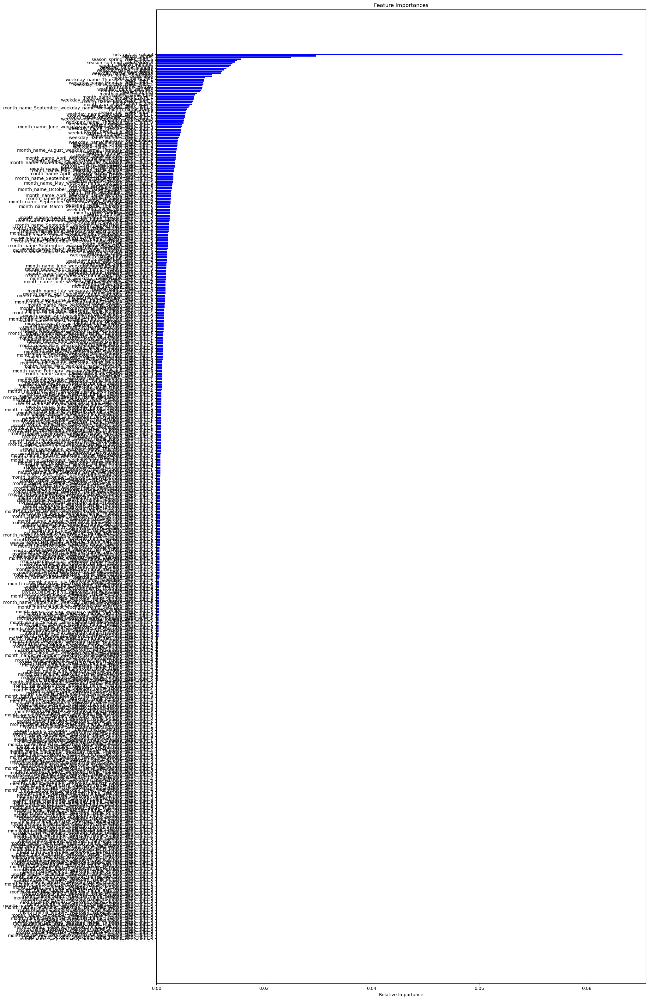

In [4]:
from sklearn.ensemble import RandomForestClassifier

X = reduced_classification_df.drop(columns = ["ds", "sby_required", "y"])
Y = reduced_classification_df["sby_required"]

RFclf = RandomForestClassifier(n_estimators=500, n_jobs=-1, random_state=42)
RFclf.fit(X, Y)
for name, importance in zip(X.columns, RFclf.feature_importances_):
    print(name, "=", importance)
    
features = X.columns
importances = RFclf.feature_importances_
indices = np.argsort(importances)

fig, ax = plt.subplots(figsize = (20, 40))
ax.set_title('Feature Importances')
ax.barh(range(len(indices)), importances[indices], color='b', align='center')
ax.set_yticks(range(len(indices)), [features[i] for i in indices])
ax.tick_params(axis = "both", labelsize = 10)
ax.set_xlabel('Relative Importance')

The question now was which ones to keep of those.
Naturally, one could simply use the k most important features of those, but then the question is how to choose k here, and I could not find a satisfactory answer for that on the web, as most sources were using their gut feeling to pick k. 

Thus, in context of the knowledge provided in the course book, statistical feature selection methods were researched.

https://machinelearningmastery.com/feature-selection-machine-learning-python/
shows SelectK where you select the k best features based on a statistical test, such as an F-test or Chi² test, but as stated above, selecting an appropriate k is still very elusive to me given my current (potentially insufficient) knowledge about the topic.

Thus, the FDR approach was chosen.
Naturally, chosing an alpha value is arbitrary as well, but at least there is a convention of choosing values like 0.05 here, which makes it easier on my conscience as I really have no clue on a what to pick as a good k without experimentation, which would take considerable amount of time.

Therefore, the FDR approach was implemented in the following.

In [5]:
from sklearn.feature_selection import SelectFdr
from sklearn.feature_selection import chi2
from numpy import set_printoptions

X = reduced_classification_df.drop(columns = ["ds", "sby_required", "y"])
Y = reduced_classification_df["sby_required"]

# feature extraction
fdr_selected = SelectFdr(score_func=chi2, alpha = 0.05)
fit = fdr_selected.fit(X, Y)

leftover_features = fit.transform(X)
leftover_indices = fit.get_support()
leftover_feature_names = list(X.columns[leftover_indices])


print(len(leftover_feature_names))
#print(leftover_feature_names)


leftover_feature_set = set(leftover_feature_names)
print(len(leftover_feature_set))


47
47


47 features remain. 

Out of interest, I wanted to know what features a k best RF feature importance method would have given when selecting k = 47 features to keep and whether there is overlap between the two methods and the features to be included in the model.

In [7]:
# from the RF method: 
features = X.columns
importances = RFclf.feature_importances_

#print(list(features))
#print(importances)

RF_features = pd.DataFrame({"features" : features, "importances": importances}).sort_values(by = "importances", ascending =  False)
RF_features = RF_features.reset_index().iloc[:47, :]["features"].to_list()
RF_features_set = set(RF_features)

In [8]:
intersection = RF_features_set.intersection(leftover_feature_set)
print(f"{len(intersection)} of the 47 features were the same in the two methods")
intersection

30 of the 47 features were the same in the two methods


{'is_weekend',
 'kids_out_of_school',
 'month_name_April_week_num_1',
 'month_name_August',
 'month_name_December',
 'month_name_January',
 'month_name_July_week_num_2',
 'month_name_June',
 'month_name_June_week_num_1',
 'month_name_June_weekday_name_Wednesday_week_num_3',
 'month_name_May',
 'month_name_May_week_num_1',
 'month_name_November',
 'month_name_September',
 'month_name_September_week_num_1',
 'month_name_September_weekday_name_Wednesday_week_num_2',
 'season_fall_week_num_1',
 'season_spring',
 'season_spring_week_num_1',
 'season_summer',
 'season_summer_week_num_1',
 'season_winter',
 'season_winter_week_num_2',
 'week_num_1',
 'week_num_4',
 'weekday_name_Friday_week_num_1',
 'weekday_name_Monday_week_num_1',
 'weekday_name_Sunday',
 'weekday_name_Thursday_week_num_1',
 'weekday_name_Wednesday_week_num_1'}

Those 30 ones will be really important as those features were kept by both methods. Interesting.


In the following, SVCs will be trained and optimized.

However, in contrast to the methods used before, there was only one training and test split here, where the training set covered 3 years, after which all days from the last year were predicted. 
Furthermore, performance comparisons among different parameters tested were mainly based on the ROC AUC, without testing the impact of specific decision thresholds on the TNR for instance while screening for parameter combinations resulting in well-performing SVCs.

While this approach may not be perfect to being able to compare the performance of the SVC classifier to the EBM classifier, it will help choose appropriate parameter combinations at least in a rather quick way.
Moreover, using the approach used before would require to train 12 times as many models, leading to very high computation times.

Thus, considering the first goal was to quickly screen for appropriate parameters on a rather coarse parameter grid, this approach appeared to make more sense.




In [6]:
last_train_day = "2018-05-15"
first_test_day = "2018-06-01"
last_test_day = "2019-05-27"

X = reduced_classification_df.drop(columns = ["sby_required", "y"])
y = reduced_classification_df[["ds", "sby_required"]]

X_train = X[X["ds"] <= last_train_day].drop(columns = "ds").astype("int")
y_train = y[y["ds"] <= last_train_day].drop(columns = "ds").astype("int").to_numpy().reshape(-1)

X_test = X[(X["ds"] >= first_test_day) &
          (X["ds"] <= last_test_day)].drop(columns = "ds").astype("int")
y_test = y[(y["ds"] >= first_test_day) &
          (y["ds"] <= last_test_day)].drop(columns = "ds").astype("int").to_numpy().reshape(-1)

X_train = X_train[leftover_feature_names].to_numpy()
X_test = X_test[leftover_feature_names].to_numpy()


In [7]:
 # oversample minority class
from imblearn.over_sampling import SMOTEN    
    
X_train, y_train = SMOTEN(random_state = 0).fit_resample(X_train, y_train)

First, a rather coarse, yet extensive grid of parameter combinations was tested.

In [11]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import recall_score

param_grid = [{"kernel": ["rbf"],
              "C": [0.01, 0.1, 1, 10,],
              "gamma": [0.01, 0.05, 0.1, 0.5, 1, 10, ]},
              {"kernel": ["poly"],
              "C": [0.01, 0.1, 1, 10, ],
              "gamma": [0.01, 0.1, 1, 10, ],
              "degree": [2, 3, 4]},
              {"kernel": ["linear"],
              "C": [0.01, 0.1, 1, 10, ]}
             ]

scoring = {"AUC" : "roc_auc", 
           "precision" : "precision",
           "accuracy" : make_scorer(accuracy_score),
           "TPR": make_scorer(recall_score),
          } 


grid_search = GridSearchCV(SVC(), 
                           param_grid, 
                           cv = 5,
                           scoring = scoring,
                          return_train_score = True, 
                          refit = "AUC") 

grid_search.fit(X_train, y_train)


GridSearchCV(cv=5, estimator=SVC(),
             param_grid=[{'C': [0.01, 0.1, 1, 10],
                          'gamma': [0.01, 0.05, 0.1, 0.5, 1, 10],
                          'kernel': ['rbf']},
                         {'C': [0.01, 0.1, 1, 10], 'degree': [2, 3, 4],
                          'gamma': [0.01, 0.1, 1, 10], 'kernel': ['poly']},
                         {'C': [0.01, 0.1, 1, 10], 'kernel': ['linear']}],
             refit='AUC', return_train_score=True,
             scoring={'AUC': 'roc_auc', 'TPR': make_scorer(recall_score),
                      'accuracy': make_scorer(accuracy_score),
                      'precision': 'precision'})

In [12]:
results = pd.DataFrame(grid_search.cv_results_)

columns_to_display = ["param_kernel", "param_C", "param_gamma", "param_degree",
                      "mean_train_AUC", "mean_test_AUC", "rank_test_AUC", 
                      "mean_train_accuracy", "mean_test_accuracy", "rank_test_accuracy",
                      "mean_train_precision", "mean_test_precision", "rank_test_precision",
                      "mean_train_TPR", "mean_test_TPR", "rank_test_TPR",
                     ]

display(results[columns_to_display].T)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75
param_kernel,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,poly,linear,linear,linear,linear
param_C,0.01,0.01,0.01,0.01,0.01,0.01,0.1,0.1,0.1,0.1,0.1,0.1,1,1,1,1,1,1,10,10,10,10,10,10,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,1,1,1,1,1,1,1,1,1,1,1,1,10,10,10,10,10,10,10,10,10,10,10,10,0.01,0.1,1,10
param_gamma,0.01,0.05,0.1,0.5,1,10,0.01,0.05,0.1,0.5,1,10,0.01,0.05,0.1,0.5,1,10,0.01,0.05,0.1,0.5,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,0.01,0.1,1,10,NaN,NaN,NaN,NaN
param_degree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,2,2,2,3,3,3,3,4,4,4,4,2,2,2,2,3,3,3,3,4,4,4,4,2,2,2,2,3,3,3,3,4,4,4,4,2,2,2,2,3,3,3,3,4,4,4,4,NaN,NaN,NaN,NaN
mean_train_AUC,0.846435,0.848652,0.852525,0.864455,0.862363,0.857846,0.846605,0.863409,0.870099,0.87171,0.869286,0.858677,0.865958,0.87241,0.882432,0.886483,0.883297,0.861341,0.87136,0.89215,0.893464,0.891028,0.868134,0.860258,0.846359,0.846335,0.87421,0.886734,0.847723,0.847648,0.89222,0.883615,0.85114,0.851143,0.894659,0.884898,0.846316,0.850005,0.888931,0.884204,0.847644,0.847697,0.891045,0.887811,0.851159,0.851147,0.885581,0.886394,0.84632,0.873343,0.889513,0.883487,0.847679,0.86082,0.885961,0.881261,0.851107,0.855203,0.877398,0.885746,0.850009,0.888295,0.886326,0.886534,0.847662,0.892553,0.886927,0.881905,0.851115,0.878765,0.882994,0.881881,0.863086,0.865696,0.873209,0.874767
mean_test_AUC,0.822089,0.821966,0.821911,0.81881,0.812854,0.809057,0.821856,0.834028,0.836651,0.82814,0.834451,0.809091,0.830094,0.839847,0.848125,0.833058,0.819247,0.806229,0.841391,0.846062,0.833085,0.813264,0.804808,0.79526,0.8262,0.8262,0.84389,0.825517,0.828236,0.828236,0.836637,0.807158,0.828407,0.828407,0.818919,0.806953,0.826419,0.8312,0.834711,0.810368,0.828236,0.828236,0.819056,0.812499,0.828427,0.828407,0.813401,0.812226,0.8262,0.8443,0.813005,0.817239,0.828236,0.835052,0.808428,0.803183,0.828386,0.832648,0.808101,0.804726,0.8312,0.83706,0.809658,0.80416,0.828236,0.836732,0.812376,0.808387,0.828407,0.838932,0.807978,0.803224,0.835332,0.833836,0.84066,0.840646
rank_test_AUC,44,45,46,51,56,63,47,18,12,38,17,62,25,8,1,21,48,70,5,2,20,54,71,76,40,40,4,43,32,37,13,68,27,27,50,69,39,23,16,60,32,32,49,57,26,27,53,59,40,3,55,52,32,15,64,75,31,22,66,72,23,10,61,73,32,11,58,65,27,9,67,74,14,19,6,7
mean_train_accuracy,0.749793,0.755579,0.767562,0.784091,0.797934,0.767562,0.750207,0.774174,0.770661,0.796074,0.808884,0.779339,0.769421,0.793802,0.80062,0.83719,0.848967,0.850413,0.790083,0.815083,0.822934,0.850413,0.850413,0.850413,0.725413,0.725413,0.789256,0.841942,0.640496,0.640496,0.800826,0.850413,0.597314,0.597314,0.820661,0.850413,0.725413,0.700207,0.81281,0.848967,0.640496,0.640496,0.843595,0.850413,0.597314,0.597314,0.85,0.850413,0.725413,0.789256,0.841942,0.848967,0.640496,0.69876,0.850413,0.850413,0.597314,0.620661,0.850413,0.850413,0.700207,0.81281,0.848967,0.848967,0.640496,0.801033,0.850413,0.850413,0.597314,0.740702,0.850413,0.850413,0.776033,0.78595,0.793388,0.805579
mean_test_accuracy,0.705785,0.704132,0.723967,0.739669,0.747934,0.756198,0.705785,0.724793,0.735537,0.74876,0.771901,0.768595,0.735537,0.768595,0.771074,0.795041,0.77438,0.77438,0.776033,0.764463,0.769421,0.784298,0.778512,0.77438,0.695868,0.695868,0.742149,0.787603,0.628926,0.628926,0.73719,0.779339,0.58595,0.58595,0.73636

The two best perfroming models in terms of roc auc are rbf kernels. 
Also, the most accurate model is rbf.

Therefore, a finer grid was used in the following params to find the best parameter combinations.

New parameter grid based on the table above:
gamma: between 0.05 and 0.1; C: 0.01 to > 10

In [13]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import recall_score

param_grid = [{"kernel": ["rbf"],
              "C": [0.05, 0.1, 1, 10, 20],
              "gamma": [0.05, 0.06, 0.07, 0.08, 0.09, 0.1]},]

scoring = {"AUC" : "roc_auc", 
           "precision" : "precision",
           "accuracy" : make_scorer(accuracy_score),
           "TPR": make_scorer(recall_score),
          } 

grid_search = GridSearchCV(SVC(), 
                           param_grid, 
                           cv = 5,
                           scoring = scoring,
                          return_train_score = True, 
                          refit = "AUC") 

grid_search.fit(X_train, y_train)


GridSearchCV(cv=5, estimator=SVC(),
             param_grid=[{'C': [0.05, 0.1, 1, 10, 20],
                          'gamma': [0.05, 0.06, 0.07, 0.08, 0.09, 0.1],
                          'kernel': ['rbf']}],
             refit='AUC', return_train_score=True,
             scoring={'AUC': 'roc_auc', 'TPR': make_scorer(recall_score),
                      'accuracy': make_scorer(accuracy_score),
                      'precision': 'precision'})

In [14]:
results = pd.DataFrame(grid_search.cv_results_)
#print(results)
#print(results.T)

columns_to_display = ["param_kernel", "param_C", "param_gamma",
                      "mean_train_AUC", "mean_test_AUC", "rank_test_AUC", 
                      "mean_train_accuracy", "mean_test_accuracy", "rank_test_accuracy",
                      "mean_train_precision", "mean_test_precision", "rank_test_precision",
                      "mean_train_TPR", "mean_test_TPR", "rank_test_TPR",
                     ]

display(results[columns_to_display].T)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
param_kernel,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf
param_C,0.05,0.05,0.05,0.05,0.05,0.05,0.1,0.1,0.1,0.1,0.1,0.1,1,1,1,1,1,1,10,10,10,10,10,10,20,20,20,20,20,20
param_gamma,0.05,0.06,0.07,0.08,0.09,0.1,0.05,0.06,0.07,0.08,0.09,0.1,0.05,0.06,0.07,0.08,0.09,0.1,0.05,0.06,0.07,0.08,0.09,0.1,0.05,0.06,0.07,0.08,0.09,0.1
mean_train_AUC,0.855943,0.858794,0.860544,0.862114,0.863455,0.864372,0.863409,0.864519,0.865841,0.866885,0.869065,0.870099,0.87241,0.875787,0.876847,0.881512,0.880671,0.882432,0.89215,0.893657,0.893913,0.894753,0.890409,0.893464,0.893793,0.889527,0.895928,0.89031,0.895504,0.893744
mean_test_AUC,0.828973,0.829779,0.830927,0.831337,0.831528,0.830217,0.834028,0.830968,0.830531,0.834328,0.833959,0.836651,0.839847,0.846172,0.84068,0.847702,0.843194,0.848125,0.846062,0.848139,0.841213,0.83788,0.830968,0.833085,0.839396,0.83579,0.835708,0.834656,0.836364,0.829602
rank_test_AUC,30,28,25,22,21,27,18,23,26,17,19,12,9,4,8,3,6,2,5,1,7,11,24,20,10,14,15,16,13,29
mean_train_accuracy,0.769008,0.769215,0.769421,0.774587,0.775413,0.775826,0.774174,0.777479,0.772521,0.772521,0.771281,0.770661,0.793802,0.792975,0.792355,0.79814,0.800207,0.80062,0.815083,0.816116,0.817975,0.819421,0.821074,0.822934,0.817769,0.820661,0.823967,0.827893,0.833264,0.837397
mean_test_accuracy,0.71405,0.713223,0.713223,0.723967,0.723967,0.720661,0.724793,0.734711,0.738843,0.733058,0.732231,0.735537,0.768595,0.775207,0.772727,0.766942,0.768595,0.771074,0.764463,0.770248,0.770248,0.765289,0.766116,0.769421,0.766942,0.766116,0.770248,0.776033,0.777686,0.78595
rank_test_accuracy,28,29,29,25,25,27,24,21,19,22,23,20,11,4,5,14,12,6,18,7,9,17,15,10,13,15,7,3,2,1
mean_train_precision,0.746861,0.739505,0.739875,0.738297,0.737749,0.738299,0.736185,0.733588,0.724856,0.723896,0.722162,0.721282,0.75132,0.753635,0.754377,0.763144,0.764091,0.765217,0.78953,0.787525,0.792359,0.792573,0.793184,0.795908,0.791859,0.793548,0.797614,0.807227,0.820396,0.827643


One more iteration to find better parameters by using a finer grid

In [15]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import recall_score

param_grid = [{"kernel": ["rbf"],
              "C": [5, 10, 25],
              "gamma": [0.05, 0.055, 0.06, 0.065, 0.07, 0.08,]},]

scoring = {"AUC" : "roc_auc", 
           "precision" : "precision",
           "accuracy" : make_scorer(accuracy_score),
           "TPR": make_scorer(recall_score),
          } 



#refit false, so I will only get the scores, 
# but no model will be retrained on the "best" score 
# as I dont know which is the single best score to consider.
# rather, I would like to get a look on how TPR, TNR and accuracy 
# change over the grid to get a feelin for the metrics.
grid_search = GridSearchCV(SVC(), 
                           param_grid, 
                           cv = 5,
                           scoring = scoring,
                          return_train_score = True, 
                          refit = "AUC") 

grid_search.fit(X_train, y_train)

#print(f"Best params: {grid_search.best_params_}")
#print(f"Best cross-validation score: {grid_search.best_score_}")

GridSearchCV(cv=5, estimator=SVC(),
             param_grid=[{'C': [5, 10, 25],
                          'gamma': [0.05, 0.055, 0.06, 0.065, 0.07, 0.08],
                          'kernel': ['rbf']}],
             refit='AUC', return_train_score=True,
             scoring={'AUC': 'roc_auc', 'TPR': make_scorer(recall_score),
                      'accuracy': make_scorer(accuracy_score),
                      'precision': 'precision'})

In [16]:
results = pd.DataFrame(grid_search.cv_results_)
#print(results)
#print(results.T)

columns_to_display = ["param_kernel", "param_C", "param_gamma",
                      "mean_train_AUC", "mean_test_AUC", "rank_test_AUC", 
                      "mean_train_accuracy", "mean_test_accuracy", "rank_test_accuracy",
                      "mean_train_precision", "mean_test_precision", "rank_test_precision",
                      "mean_train_TPR", "mean_test_TPR", "rank_test_TPR",
                     ]

display(results[columns_to_display].T)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
param_kernel,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf,rbf
param_C,5,5,5,5,5,5,10,10,10,10,10,10,25,25,25,25,25,25
param_gamma,0.05,0.055,0.06,0.065,0.07,0.08,0.05,0.055,0.06,0.065,0.07,0.08,0.05,0.055,0.06,0.065,0.07,0.08
mean_train_AUC,0.887204,0.887541,0.891803,0.892324,0.891008,0.8901,0.89215,0.893225,0.893657,0.894521,0.893913,0.894753,0.890112,0.891708,0.890504,0.887392,0.89284,0.890728
mean_test_AUC,0.844642,0.849095,0.848057,0.843481,0.846431,0.840393,0.846062,0.840352,0.848139,0.84068,0.841213,0.83788,0.833659,0.832293,0.842866,0.837894,0.836172,0.837894
rank_test_AUC,6,1,3,7,4,11,5,12,2,10,9,15,17,18,8,14,16,13
mean_train_accuracy,0.808471,0.810124,0.81157,0.812603,0.814463,0.816116,0.815083,0.815909,0.816116,0.817975,0.817975,0.819421,0.819835,0.821281,0.823347,0.825207,0.827686,0.833884
mean_test_accuracy,0.759504,0.76281,0.761983,0.76281,0.766942,0.763636,0.764463,0.763636,0.770248,0.766116,0.770248,0.765289,0.769421,0.766942,0.770248,0.770248,0.776033,0.780992
rank_test_accuracy,18,15,17,15,8,13,12,14,3,10,6,11,7,9,3,3,2,1
mean_train_precision,0.780524,0.781822,0.785199,0.786486,0.788306,0.786055,0.78953,0.786495,0.787525,0.790301,0.792359,0.792573,0.792894,0.794048,0.796962,0.800266,0.807392,0.821411


rbf C = 5, gamma = 0.055 and C = 10, gamma = 0.06 both work well.
The mean test auc is only marginally different suggesting that it may not be worthwile testing any further combinations. 

## Comparing EBM to SVC

To compare the performance of the EBM to the SVC, the SVC was combined with regressors to compare the performance of the two models on by using the business metrics.

Again, different decision thresholds were tested.

In [11]:
import pandas as pd
import holidays
import itertools
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_transformer
import matplotlib.pyplot as plt
from sktime.performance_metrics.forecasting import make_forecasting_scorer
import numpy as np
from imblearn.over_sampling import SMOTE, ADASYN, BorderlineSMOTE, RandomOverSampler, SMOTEN
from sktime.forecasting.tbats import TBATS

In [44]:
def interpretable_scores(y_true, y_pred, debug_printing = False):
    """ 
        
    Score function based on the business goals.
    
    inputs have to be np arrays.
    
    calculates two losses based on the business goals.
    
    first goal: 
    loss is the percent difference in activated sby drivers
    
    values over 100 % drivers activated need to be capped to 100% or penalized.
    otherwise, underpredicting would be beneficial.
    
    first, I calculate a loss_1 where I decided to cap the value for the percentage of activated drivers to 100.
    thereby, the magnitude of underpredicting will not be penalized. 
    instead, the loss is the literal efficiency of sby driver activation.
    importantly, this will give you a positive loss in the following example:
    true: 100, benchmark: 90, pred: 110.
    both the benchmark and the pred are off by 10, 
    but you've lost efficiency by overpredicting!
    
   
    second goal:
    count delta of number of occasions on which additional sby drivers 
    have to be recruited.
    
    furthermore, the magnitude of underpredictions is calculated to judge whether
    the model under investigation is getting closer to the true value when underpredicting 
    than the baseline. 

    """
    import math
    
        
    #################
    # 1. goal
    #################
    
    # compare the mean percentage of sby drivers being activated.
    benchmark_sby_activated = (1 - (90 - y_true) / 90) * 100
    pred_sby_activated = np.where(y_pred!=0,  (1 - (y_pred - y_true) / y_pred) * 100, 100)
    
    if debug_printing == True:
        print("1st goal: efficiency of sby driver activation")
        print(f"benchmark_sby_activated: {benchmark_sby_activated}")
        print(f"pred_sby_activated: {pred_sby_activated}")
        
    #cap the % activation to 100.
    benchmark_sby_activated[benchmark_sby_activated > 100] = 100
    pred_sby_activated[pred_sby_activated > 100] = 100
    
    if debug_printing == True:
        print("after capping:")
        print(f"benchmark_sby_activated: {benchmark_sby_activated}")
        print(f"pred_sby_activated: {pred_sby_activated}")
    
    #unpenalized efficiency score
    avg_benchmark_sby_activated = np.mean(benchmark_sby_activated)
    avg_pred_sby_activated = np.mean(pred_sby_activated)  
    
    # if the difference is < 0 we are meeting business goals
    loss_1 = avg_benchmark_sby_activated - avg_pred_sby_activated

    if debug_printing == True:
        print("averages:")
        print(f"benchmark_sby_activated: {avg_benchmark_sby_activated}")
        print(f"pred_sby_activated: {avg_pred_sby_activated}")
        print(f"On average, the prediction is {loss_1} % less efficient.")

    #################
    # 2. goal
    #################
    
    num_times_benchmark_undershoots = np.count_nonzero(y_true > 90)
    num_times_pred_undershoots = np.count_nonzero(y_true > y_pred)

    # if the difference is y < we are meeting business goals
    loss_2 = num_times_pred_undershoots - num_times_benchmark_undershoots
        
    if debug_printing == True:
        print("\n2nd goal: number of times undershooting")
        print(f"num_times_benchmark_undershoots: {num_times_benchmark_undershoots}")
        print(f"num_times_pred_undershoots: {num_times_pred_undershoots}") 
        print(f"Your predictions undershoot {loss_2} times more often.")
        
    #2. goal: the average magnitude of undershooting, 
    # i.e., the average gap between the preds and the trues
    benchmark_gaps = y_true - 90
    y_pred_gaps = y_true - y_pred
    
    if debug_printing == True:
        print("\n2nd goal: avg number additional drivers required when undershooting")
        print(f"benchmark_gaps: {benchmark_gaps}")
        print(f"y_pred_gaps: {y_pred_gaps}") 
    
    #filter the negative values
    benchmark_gaps = [x for x in benchmark_gaps if x > 0]
    y_pred_gaps = [x for x in y_pred_gaps if x > 0]
    
    if debug_printing == True:
        print("after filtering out values <= 0")
        print(f"benchmark_gaps: {benchmark_gaps}")
        print(f"y_pred_gaps: {y_pred_gaps}") 
    
    #average gap sizes
    avg_benchmark_gaps = np.mean(benchmark_gaps)
    avg_pred_gaps = np.mean(y_pred_gaps) 
    
    # the avg can be nan if there no values,
    # so they're set to 0 here
    if math.isnan(avg_benchmark_gaps):
        avg_benchmark_gaps = 0
    if math.isnan(avg_pred_gaps):
        avg_pred_gaps = 0
    
    #delta: lower is better
    loss_3 = avg_pred_gaps - avg_benchmark_gaps 
            
    if debug_printing == True:
        print(f"avg_benchmark_gaps: {avg_benchmark_gaps}")
        print(f"avg_pred_gaps: {avg_pred_gaps}")
        print(f"On average, {loss_3} additional drivers have to be recruited compared to benchmark when underpredicting.\n")
        
    return loss_1, loss_2, loss_3



In [1]:
def cv_sktime_models_one_year(model, statsforecast_df, splits_dict, custom_scorer, plotting = True,
                     print_per_month = True, print_mean = True, transformer = None, smoothing = None,
                             interval = None):
    """
    function to perform cv for a given model
    
    For some reason, this function always throws the "returning a view versus a copy" warning
    (https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy)
    when rolling windows are calculated or transformers are used.
    I have no clue why they are thrown however, as .loc is used wherever possible.
    the rolling method appears to be correctly implemented as well
    https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html
    
    
    """

    from sktime.transformations.series.boxcox import LogTransformer
    from sktime.transformations.series.boxcox import BoxCoxTransformer
    from sktime.forecasting.base import ForecastingHorizon
    
    #init lists to append scores for single months 
    # to calculate average scores for all folds
    efficiency_losses = []
    num_undershoots = []
    magnitude_undershoots = []
    y_pred_list = []
    regressors = []
    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
        # a counter to get the correct ax object
        i = 0
    
    for split in splits_dict.keys(): 
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]
        leading_days = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds < first_test_day)])
        
        #calculate the length of the forecasting horizon
        horizon = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds <= last_test_day)])  
        
        #extract train and test data
        Y_train_df = statsforecast_df.loc[statsforecast_df.ds <= last_train_day, :]
        Y_test_df = statsforecast_df.loc[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day), :]
        
        #print(Y_train_df)
        
        #smooth the data
        if smoothing == "MA_weekly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 7, center = True, closed = "both", min_periods = 1).mean()
        elif smoothing == "MA_monthly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 31, center = True, closed = "both", min_periods = 1).mean()
        if smoothing == "MA_oneday":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()
        elif smoothing == "EWM_monthly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].ewm(span = 30, min_periods = 1).mean()
        elif smoothing == "EWM_weekly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].ewm(span = 7, min_periods = 1).mean()
            
        #print(Y_train_df)
        
        #transform train data
        if transformer == "ln":
            trafo_obj = LogTransformer(offset = 1)#
            Y_train_transformed = trafo_obj.fit_transform(Y_train_df.loc[:, "y"])
            Y_train_df.loc[:, "y"] = Y_train_transformed
        elif transformer == "boxcox":
            # no offset param available. 
            trafo_obj = BoxCoxTransformer()
            Y_train_transformed = trafo_obj.fit_transform(Y_train_df.loc[:, "y"] + 1)
            Y_train_df.loc[:, "y"] = Y_train_transformed 
                
        
        #fit and predict
        model_obj = model
        model_obj.fit(Y_train_df.loc[:, 'y'].values)
        regressors.append(model_obj)
        
        if interval != None:
            Y_hat_df = pd.DataFrame({"y": model_obj.predict_interval(np.arange(leading_days, horizon), 
                                                                    coverage  = interval)["Coverage"][interval]["upper"]})
        else:
            Y_hat_df = pd.DataFrame({"y": model_obj.predict(np.arange(leading_days, horizon)).reshape(1,-1)[0]})
            # some models make negative predictions, so those should be set to zero
        Y_hat_df[Y_hat_df["y"] < 0] = 0
                
        #transform back
        if transformer == "ln":
            Y_train_rev_transformed = trafo_obj.inverse_transform(Y_train_df.loc[:, "y"] )
            Y_train_df.loc[:, "y"] = Y_train_rev_transformed
            Y_hat_rev_transformed = trafo_obj.inverse_transform(Y_hat_df.loc[:, "y"])
            Y_hat_df.loc[:, "y"] = Y_hat_rev_transformed
            
        elif transformer == "boxcox":
            # as there is no offset available when initializing the 
            # transformer object, you have to manually subtract 1
            Y_train_rev_transformed = trafo_obj.inverse_transform(Y_train_df.loc[:, "y"] ) - 1
            Y_train_df.loc[:, "y"] = Y_train_rev_transformed
            Y_hat_rev_transformed = trafo_obj.inverse_transform(Y_hat_df.loc[:, "y"]) - 1
            Y_hat_df.loc[:, "y"] = Y_hat_rev_transformed
        
        #get arrays of the data for metrics        
        y_trues = Y_test_df.loc[:, 'y'].values
        y_preds = Y_hat_df.loc[:, 'y'].values
        
        #calculate metrics
        efficiency_loss, num_undershoots_loss, magnitude_undershoots_loss = custom_scorer(y_trues, y_preds)
        efficiency_losses.append(efficiency_loss)
        num_undershoots.append(num_undershoots_loss)
        magnitude_undershoots.append(magnitude_undershoots_loss)
        y_pred_list.append(y_preds)

        if plotting == True:
        # plotting
            ax = axes.flat[i]
    
            ax.plot(Y_test_df.ds, y_trues, label = "y")
            ax.plot(Y_test_df.ds, y_preds, label = "y_hat")
            ax.set_title(month, size = 20)    
            ax.set_ylabel("Number of standby drivers", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.axhline(y = 90, xmin = 0, xmax = 1, color = "red",
                label = "current policy: 90 drivers")
            ax.legend()
    
            # iterate the counter for the ax object
            i += 1
        
        if print_per_month == True:                
            print(f"\nSplit for {month}")
            print(f"Forecasting for {str(horizon - leading_days)} days")
            print(f"Number of leading days: {leading_days}")
            print(f"Loss in efficiency = {efficiency_loss}")
            print(f"Number of additional underpredictions = {num_undershoots_loss}")
            print(f"Number of additional sby drivers required = {magnitude_undershoots_loss}")
    
    if print_mean == True:
        print("\n")
        print(f"Mean efficiency loss per month in percent = {np.mean(efficiency_losses)}")
        print(f"Mean number of additional underpredictions = {np.mean(num_undershoots)}")
        print(f"Mean number of additional sby drivers required = {np.mean(magnitude_undershoots)}")
    
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(regressors, 
                      y_pred_list,
                     efficiency_losses,
                     num_undershoots,
                     magnitude_undershoots))

    output_df = pd.DataFrame(zipped, columns = ["regressors",
                                                "y_pred_list",
                                                "efficiency_losses",
                                                "num_undershoots",
                                                "magnitude_undershoots"])
    
    return output_df


        

In [28]:
def combine_clf_reg(statsforecast_df, clf_probas, reg_preds, splits_dict, custom_scorer, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.2, plot_historical = True):
    """
    function to perform cv for a given statsforecast model
    
    
    """

    #init lists to append scores for single months 
    # to calculate average scores for all folds
    efficiency_losses = []
    num_undershoots = []
    magnitude_undershoots = []
    y_trues_list = []
    y_preds_list = []
    y_uncorr_preds_list = []
    X_tests = []
    y_tests = []
    dates_list = []
    feature_names_list = []
    test_dfs = []

    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
    
    # a counter to get the correct ax object and month
    i = 0
    
    for split in splits_dict.keys(): 
        
        #print(split)
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]
        
        #extract train and test data
        X_test_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)].drop(columns = ["ds", "sby_required", 
                                                                                            "y",])
        Y_test_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]["y"]
        
        dates = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]["ds"]
        
        test_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]

        
        X_tests.append(X_test_df.values)
        feature_names_list.append(X_test_df.columns.values)
        y_tests.append(Y_test_df.values)
        dates_list.append(dates.values)
        
        
        #calculate the length of the forecasting horizon
        horizon = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds <= last_test_day)])  
        
        #for the preds, you have to get rid of the timepoints 
        #from the last_train_day to the first_test_day, i.e.,
        #the leading period = approximately 15 days, depending on the month
        leading_days = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds < first_test_day)])
        
        
        probas = clf_probas[i]
        probas_bin = (probas >= decision_thr)
        y_hat = reg_preds[i]   
        y_hat_x_probas_bin = y_hat * probas_bin

        y_trues = Y_test_df.values.astype("float64") #manual typing required, otherwise bug in metrics calculations
       
        y_trues_list.append(y_trues)
        y_preds_list.append(y_hat_x_probas_bin)
        y_uncorr_preds_list.append(y_hat)
        
        # insert the probas and preds into test_df for output for later error explainability
        test_df["probas"] = probas
        test_df["y_preds"] = y_hat_x_probas_bin
        test_df["y_trues"] = y_trues # will be float64, thereby wrong types will not create issues later
        test_df["y_preds_uncorr"] = y_hat
        test_dfs.append(test_df)
        
        #calculate metrics
        efficiency_loss, num_undershoots_loss, magnitude_undershoots_loss = custom_scorer(y_trues, y_hat_x_probas_bin)
        efficiency_losses.append(efficiency_loss)
        num_undershoots.append(num_undershoots_loss)
        magnitude_undershoots.append(magnitude_undershoots_loss)
        
        if plotting == True:
        # plotting
            ax = axes.flat[i]    
            ax.plot(dates, y_trues, label = "y", linewidth = "5")
            ax.plot(dates, y_hat_x_probas_bin, label = "y_hat_x_probas_bin", linewidth = "5")
            ax.set_title(month, size = 30)    
            ax.set_ylabel("Number of standby drivers", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.axhline(y = 90, xmin = 0, xmax = 1, color = "grey",
                label = "current policy: 90 drivers", linewidth = "5")
                    
            if plot_historical == True:
                #get the training data 
                previous_years_months = statsforecast_df[(statsforecast_df.ds <= last_train_day)]
                
                #create features to slice the data
                previous_years_months["day_of_month"] = previous_years_months["ds"].dt.day
                previous_years_months["month_name"] = previous_years_months["ds"].dt.month_name()
                previous_years_months["year"] = previous_years_months["ds"].dt.year
                
                #get data from the same months of the previous years
                previous_years_months = previous_years_months[previous_years_months["month_name"] == month]
                
                for year in previous_years_months.year.unique():
                    y = previous_years_months[previous_years_months["year"] == year].y
                    
                    # in 2019 there are only 27 days in May available,
                    # so I exclude all days later than that in the plot
                    if 2019 in dates.dt.year.unique(): #check if the current year to be plotted is 2019
                        if month == "May":
                            y = y[:27]
                        
                    ax.plot(dates, y.values, linestyle = "--", label = f"y in {year}")
                                
                
            ax.legend()
            
        fig.subplots_adjust(hspace = 0.5)
    
        # iterate the counter for the ax object and month
        i += 1
        
        if print_per_month == True:                
            print(f"\nSplit for {month}")
            print(f"Forecasting for {str(horizon - leading_days)} days")
            print(f"Number of leading days: {leading_days}")
            print(f"Loss in efficiency = {efficiency_loss}")
            print(f"Number of additional underpredictions = {num_undershoots_loss}")
            print(f"Number of additional sby drivers required = {magnitude_undershoots_loss}")
    
    if print_mean == True:
        print("\n")
        print(f"Mean efficiency loss per month in percent = {np.mean(efficiency_losses)}")
        print(f"Mean number of additional underpredictions = {np.mean(num_undershoots)}")
        print(f"Mean number of additional sby drivers required = {np.mean(magnitude_undershoots)}")
    
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(efficiency_losses, 
                      num_undershoots,
                     magnitude_undershoots,
                     y_trues_list,
                     y_preds_list,
                     y_uncorr_preds_list,
                     X_tests,
                     y_tests,
                     dates_list,
                     feature_names_list,
                     test_dfs))

    output_df = pd.DataFrame(zipped, columns = ["efficiency_losses",
                                                "num_undershoots",
                                                "magnitude_undershoots",
                                                "y_trues_list",
                                                "y_preds_list",
                                                "y_uncorr_preds_list",
                                               "X_tests",
                                               "y_tests",
                                               "dates_list",
                                               "feature_names_list",
                                               "test_df"])

    
    return output_df

In [13]:
year_split = {"first": {"last_train_day": "2018-05-15",
                   "first_test_day": "2018-06-01",
                   "last_test_day": "2018-06-30",
                   "month": "June"},
              
                "second": {"last_train_day": "2018-06-15",
                   "first_test_day": "2018-07-01",
                   "last_test_day": "2018-07-31",
                   "month": "July"},
              
                "third": {"last_train_day": "2018-07-15",
                   "first_test_day": "2018-08-01",
                   "last_test_day": "2018-08-31",
                   "month": "August"},
              
                "fourth": {"last_train_day": "2018-08-15",
                   "first_test_day": "2018-09-01",
                   "last_test_day": "2018-09-30",
                   "month": "September"},
              
                "fifth": {"last_train_day": "2018-09-15",
                   "first_test_day": "2018-10-01",
                   "last_test_day": "2018-10-31",
                   "month": "October"},
              
                "sixth": {"last_train_day": "2018-10-15",
                   "first_test_day": "2018-11-01",
                   "last_test_day": "2018-11-30",
                   "month": "November"},
              
                "seventh": {"last_train_day": "2018-11-15",
                   "first_test_day": "2018-12-01",
                   "last_test_day": "2018-12-31",
                   "month": "December"},
              
                "eighth": {"last_train_day": "2018-12-15",
                   "first_test_day": "2019-01-01",
                   "last_test_day": "2019-01-31",
                   "month": "January"},              
    
                "nineth": {"last_train_day": "2019-01-15",
                   "first_test_day": "2019-02-01",
                   "last_test_day": "2019-02-28",
                   "month": "February"},
          
                 "tenth": {"last_train_day": "2019-02-15",
                   "first_test_day": "2019-03-01",
                   "last_test_day": "2019-03-31",
                   "month": "March"},
          
                 "eleventh": {"last_train_day": "2019-03-15",
                   "first_test_day": "2019-04-01",
                   "last_test_day": "2019-04-30",
                  "month": "April"},
          
                 "twelvth": {"last_train_day": "2019-04-15",
                   "first_test_day": "2019-05-01",
                   "last_test_day": "2019-05-27",
                   "month": "May"}
         }


In [45]:
def calc_confusion(y_true, y_pred):
    
    df = pd.DataFrame({"true": y_true, "pred": y_pred})
    
    TP = len(df[(df["true"] == 1) & (df["pred"] == 1)])
    TN = len(df[(df["true"] == 0) & (df["pred"] == 0)])
    FP = len(df[(df["true"] == 0) & (df["pred"] == 1)])
    FN = len(df[(df["true"] == 1) & (df["pred"] == 0)])
    
    if TP + FN == 0:
        TRP = 0
    else:
        TRP = TP / (TP + FN)
        
    if TN + FP == 0:
        TNR = 0
    else:
        TNR = TN / (TN + FP)
    
    if TP + FP == 0:
        prec = 0
    else:
        prec = TP / (TP + FP)
    
    return TP, FP, TN, FN, TRP, TNR, prec
    
#calc_confusion(np.array([0, 0, 1, 1]), np.array([0,1,0,1]))

In [15]:
def cv_svm_class_one_year(statsforecast_df, splits_dict, custom_scorer, plotting = True, 
                          oversampler = "None", decision_thr = 0.2,
                         print_mean = True, print_per_month = False):
    """
    function to perform cv for a given model
    
    
    """

    
    #init lists to append probas and classifiers for single months 
    train_proba_list = []
    train_pred_list = [] # binary prediction based on decision thr 
    train_TPs = []
    train_FPs = []
    train_TNs = []
    train_FNs = []
    train_TPRs = []
    train_TNRs = []
    train_precisions = []
    
    test_proba_list = []
    test_pred_list = [] # binary prediction based on decision thr 
    test_TPs = []
    test_FPs = []
    test_TNs = []
    test_FNs = []
    test_TPRs = []
    test_TNRs = []
    test_precisions = []
    
    classifiers = []
    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
        # a counter to get the correct ax object
        i = 0
    
    for split in splits_dict.keys(): 
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]

        #classifier dfs
        X_train_clf_df = statsforecast_df[statsforecast_df.ds <= last_train_day].drop(columns = ["ds", "sby_required", 
                                                                                                 "y"])
        Y_train_clf_df = statsforecast_df[statsforecast_df.ds <= last_train_day]["sby_required"]
        X_test_clf_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)].drop(columns = ["ds", "sby_required", 
                                                                                            "y"])
        Y_test_clf_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]["sby_required"]      

        if oversampler == "smote":
            X_train_clf_df, Y_train_clf_df = SMOTE(random_state = 0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))
        elif oversampler == "smoten":
            X_train_clf_df, Y_train_clf_df = SMOTEN(random_state = 0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))
            #print(X_train_clf_df)
        elif oversampler == "adasyn":
            X_train_clf_df, Y_train_clf_df = ADASYN(random_state = 0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))
        elif oversampler == "random":
            X_train_clf_df, Y_train_clf_df = RandomOverSampler(random_state=0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))

        clf = SVC(C = 0.05, kernel = "rbf", gamma = 0.055, probability = True)
        
        clf.fit(X_train_clf_df, Y_train_clf_df)
        classifiers.append(clf)
                
        # get insample predictions   
        train_probas = clf.predict_proba(X=X_train_clf_df)[:,1] #select the probas for class 1
        train_proba_list.append(train_probas)
        train_pred = train_probas > decision_thr
        train_pred_list.append(train_pred)
        
        train_TP, train_FP, train_TN, train_FN, train_TPR, train_TNR, train_prec = calc_confusion(Y_train_clf_df.values, 
                                                                                                 train_pred)
        
        train_TPs.append(train_TP)
        train_FPs.append(train_FP)
        train_TNs.append(train_TN)
        train_FNs.append(train_FN)
        train_TPRs.append(train_TPR)
        train_TNRs.append(train_TNR)
        train_precisions.append(train_prec)
        
        # get test predictions
        test_probas = clf.predict_proba(X=X_test_clf_df)[:,1] #select the probas for class 1
        test_proba_list.append(test_probas)
        test_pred = test_probas > decision_thr
        test_pred_list.append(test_pred)
        
        test_TP, test_FP, test_TN, test_FN, test_TPR, test_TNR, test_prec = calc_confusion(Y_test_clf_df.values, 
                                                                                                 test_pred)
        
        test_TPs.append(test_TP)
        test_FPs.append(test_FP)
        test_TNs.append(test_TN)
        test_FNs.append(test_FN)
        test_TPRs.append(test_TPR)
        test_TNRs.append(test_TNR)
        test_precisions.append(test_prec)
        
        if print_per_month:
            print(f"\n\nmonth {month}\n\n")
            print(f"train_TPR: {train_TPR}")
            print(f"train_TNR: {train_TNR}")
            print(f"train_prec: {train_prec}")
            print(f"\ntest_TPR: {test_TPR}")
            print(f"test_TNR: {test_TNR}")
            print(f"test_prec: {test_prec}")
        
        if plotting == True:
        # plotting
            ax = axes.flat[i]
    
            ax.plot(Y_test_clf_df.index, Y_test_clf_df, label = "sby_req")
            ax.plot(Y_test_clf_df.index, test_probas, label = "probas")
            ax.set_title(month, size = 20)    
            ax.set_ylabel("sby are required", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.legend()
    
            # iterate the counter for the ax object
            i += 1

    if print_mean:
            print(f"\nmean train_TPR: {np.mean(train_TPRs)}")
            print(f"mean train_TNR: {np.mean(train_TNRs)}")
            print(f"mean train_prec: {np.mean(train_precisions)}")
            print(f"\nmean test_TPR: {np.mean(test_TPRs)}")
            print(f"mean test_TNR: {np.mean(test_TNRs)}")
            print(f"mean test_prec: {np.mean(test_precisions)}")
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(classifiers, 
                      test_proba_list))

    output_df = pd.DataFrame(zipped, columns = ["classifiers",
                                               "test_proba_list"])
    
    return output_df

In [21]:
selected_df = reduced_classification_df[leftover_feature_names + ["ds", "y", "sby_required"]]

selected_df

,season_spring,season_summer,season_winter,week_num_1,week_num_4,month_name_August,month_name_December,month_name_February,month_name_January,month_name_June,month_name_May,month_name_November,month_name_September,weekday_name_Sunday,is_weekend,kids_out_of_school,season_spring_week_num_1,season_summer_week_num_1,season_fall_week_num_1,season_winter_week_num_2,season_winter_week_num_3,season_winter_week_num_4,month_name_April_week_num_1,month_name_May_week_num_1,month_name_June_week_num_1,month_name_July_week_num_1,month_name_July_week_num_2,month_name_August_week_num_1,month_name_September_week_num_1,weekday_name_Friday_week_num_1,weekday_name_Sunday_week_num_2,weekday_name_Sunday_week_num_4,weekday_name_Monday_week_num_1,weekday_name_Wednesday_week_num_1,weekday_name_Thursday_week_num_1,month_name_April_weekday_name_Friday_week_num_1,month_name_May_weekday_name_Saturday_week_num_1,month_name_June_weekday_name_Friday_week_num_1,month_name_June_weekday_name_Monday_week_num_1,month_name_June_weekday_name_Wednesday_week_num_3,month_name_July_weekday_name_Friday_week_num_2,month_name_July_weekday_name_Monday_week_num_1,month_name_August_weekday_name_Thursday_week_num_3,month_name_September_weekday_name_Friday_week_num_1,month_name_September_weekday_name_Wednesday_week_num_2,month_name_November_weekday_name_Thursday_week_num_1,month_name_March_weekday_name_Thursday_week_num_1,ds,y,sby_required
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2016-04-01,4.0,1
1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2016-04-02,70.0,1
2,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1,0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2016-04-03,0.0,0
3,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2016-04-04,0.0,0
4,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2016-04-05,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1147,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2019-05-23,0.0,0
1148,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2019-05-24,0.0,0
1149,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2019-05-25,146.0,1
1150,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2019-05-26,160.0,1



In the following plot, you can see the probabilities returned by the SVC on the y axis.

Probabilities are generally higher than in the EBM, suggesting that higher decision thresholds than before should be tested as well. 


I will comment on the performance of the combined models teseted at the end of the notebook.


mean train_TPR: 0.9783771186248277
mean train_TNR: 0.38171327799664395
mean train_prec: 0.6128293324164088

mean test_TPR: 0.8330493702204228
mean test_TNR: 0.38124126892206084
mean test_prec: 0.44499079857282337


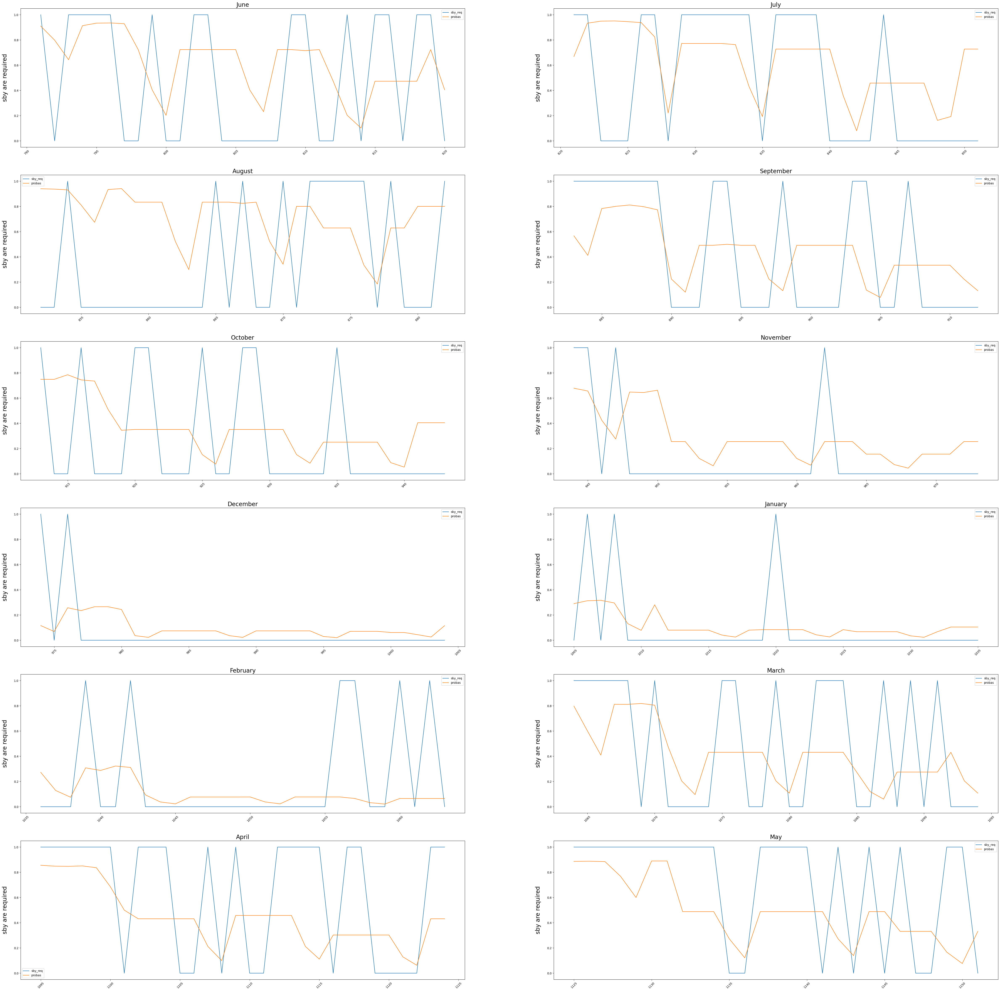

In [23]:
clf_output = cv_svm_class_one_year(selected_df, year_split, interpretable_scores,
                                   plotting = True, print_per_month = False, print_mean = True,
                                   oversampler = "smoten",)

In [25]:
clf_probas = clf_output["test_proba_list"].to_list()

/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.9634017415017837
Number of additional underpredictions = -3
Number of additional sby drivers required = -2.554859804956422


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 12.440420402343637
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 9.143955036770652
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 8.361272326080584
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 2.4652957104976743
Number of additional underpredictions = -2
Number of additional sby drivers required = -15.005733660998281


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for November
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.43989420659892264
Number of additional underpredictions = 0
Number of additional sby drivers required = -74.29934299050566


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for December
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 1.1247249051474322
Number of additional underpredictions = 0
Number of additional sby drivers required = -14.051038302530372


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for January
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 1.6285416689534928
Number of additional underpredictions = -1
Number of additional sby drivers required = -27.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = 3.613377826089792
Number of additional underpredictions = 0
Number of additional sby drivers required = -52.88996526627882


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = 3.9807529230160412
Number of additional underpredictions = -4
Number of additional sby drivers required = -10.568336650661223


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 13.349682961154315
Number of additional underpredictions = -8
Number of additional sby drivers required = -27.067783978987222


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 16.921030568514723
Number of additional underpredictions = -8
Number of additional sby drivers required = -82.72990422618653


Mean efficiency loss per month in percent = 6.452695856389088
Mean number of additional underpredictions = -3.1666666666666665
Mean number of additional sby drivers required = -37.733628882722215


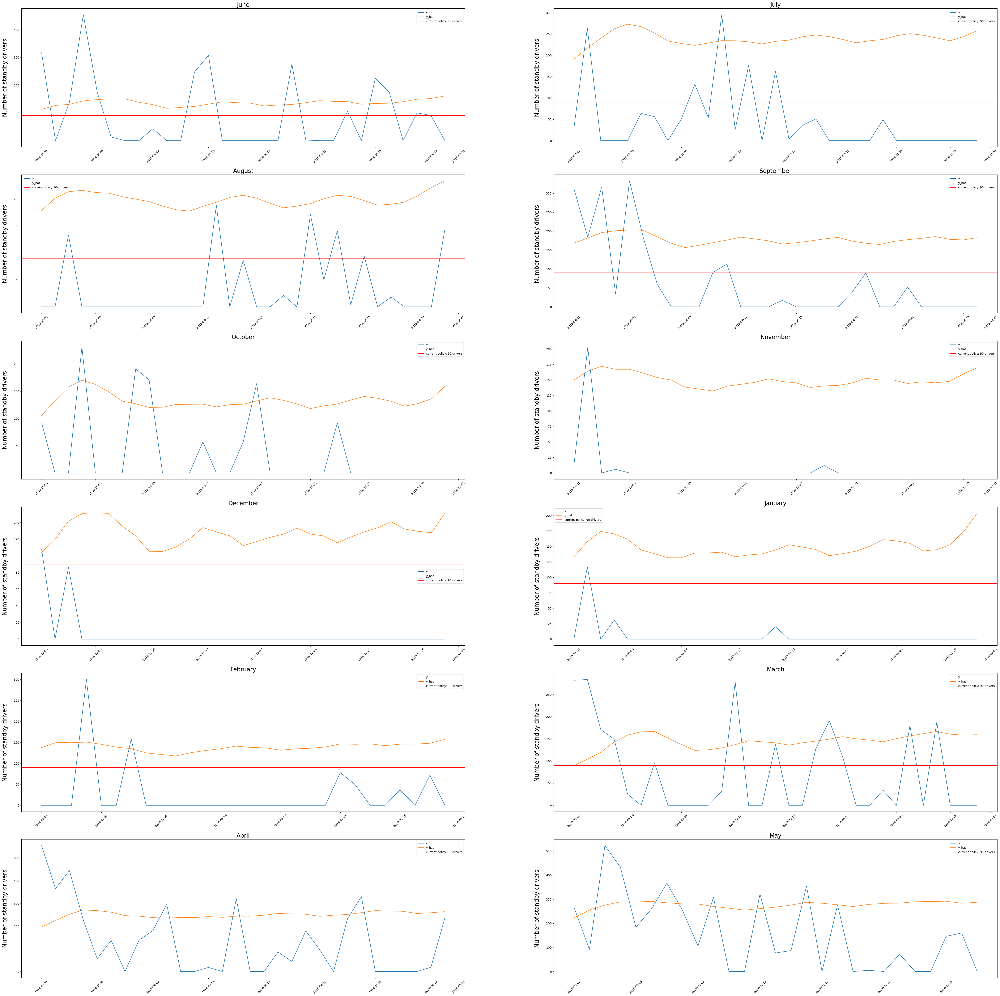

In [29]:
# tbats smoothed interval


forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
tbats_valid_oneday_interval_big_df = cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True, interval = 0.7) 

In [30]:
tbats_valid_oneday_interval_big = tbats_valid_oneday_interval_big_df["y_pred_list"].to_list()

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.9634017415017837
Number of additional underpredictions = -3
Number of additional sby drivers required = -2.554859804956422

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 9.214613950730737
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 9.143955036770652
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 5.027938992747252
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -10.437930095953934
Number of additional underpredictions = -2
Nu

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = -69.2063492063492
Number of additional underpredictions = 4
Number of additional sby drivers required = -70.96332175542626

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -1.7051091844864104
Number of additional underpredictions = -3
Number of additional sby drivers required = -15.921854800587752

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 6.6830162944876506
Number of additional underpredictions = -8
Number of additional sby drivers required = -27.067783978987222


/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 15.306937933213298
Number of additional underpredictions = -7
Number of additional sby drivers required = -74.93033286457987


Mean efficiency loss per month in percent = -15.840775088222225
Mean number of additional underpredictions = -2.5833333333333335
Mean number of additional sby drivers required = -37.36923748917783


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,3.963402,-3,-2.554860,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,9.214614,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,9.143955,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,5.027939,-3,-29.696617,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-10.437930,-2,-15.005734,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-12.893439,0,-74.299343,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-76.294630,0,-14.051038,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[104.05103830253037, 0.0, 141.70588027695175, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-68.891707,0,-7.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[133.1416932119767, 157.84775254635736, 174.48...","[133.1416932119767, 157.84775254635736, 174.48...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-69.206349,4,-70.963322,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[137.6335203614402, 150.11200385972478, 0.0, 1...","[137.6335203614402, 150.11200385972478, 149.29...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season_

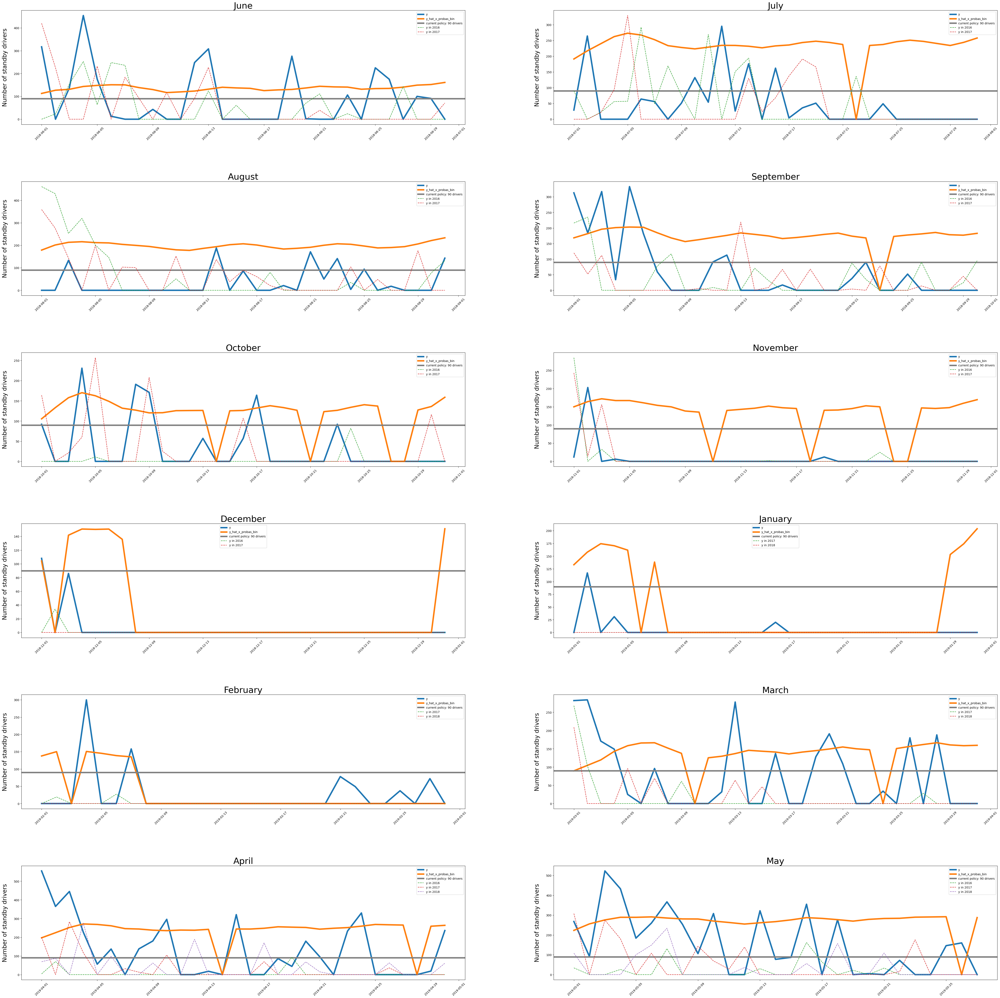

In [31]:
# decision threshold 0.1

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.1)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.630068408168448
Number of additional underpredictions = -3
Number of additional sby drivers required = -2.554859804956422

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 9.214613950730737
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 9.143955036770652
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.180169792717898
Number of additional underpredictions = -1
Number of additional sby drivers required = -44.9644110345813

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -10.437930095953934
Number of additional underpredictions = -2
Numb

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = -72.77777777777779
Number of additional underpredictions = 4
Number of additional sby drivers required = -70.96332175542626

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -11.38252853932513
Number of additional underpredictions = -3
Number of additional sby drivers required = -15.921854800587752

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 1.3316840686874585
Number of additional underpredictions = -7
Number of additional sby drivers required = -34.772386267703325

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 7.899530525805893
Number of additional underpredictions = -7
Number of additional sby drivers required = -74.93033286457987


Mean efficiency loss per month in percent = -21.119502471805937
Mean number of additional underpredictions = -2.3333333333333335
Mean number 

,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,0.630068,-3,-2.554860,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,9.214614,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,9.143955,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-6.180170,-1,-44.964411,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-10.437930,-2,-15.005734,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-19.560106,0,-74.299343,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-79.520436,0,90.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 141.70588027695175, 150.67926813999...","[104.05103830253037, 119.66643386796027, 141.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-81.794933,0,-7.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[133.1416932119767, 157.84775254635736, 174.48...","[133.1416932119767, 157.84775254635736, 174.48...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-72.777778,4,-70.963322,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[137.6335203614402, 0.0, 0.0, 150.677667985080...","[137.6335203614402, 150.11200385972478, 149.29...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season_

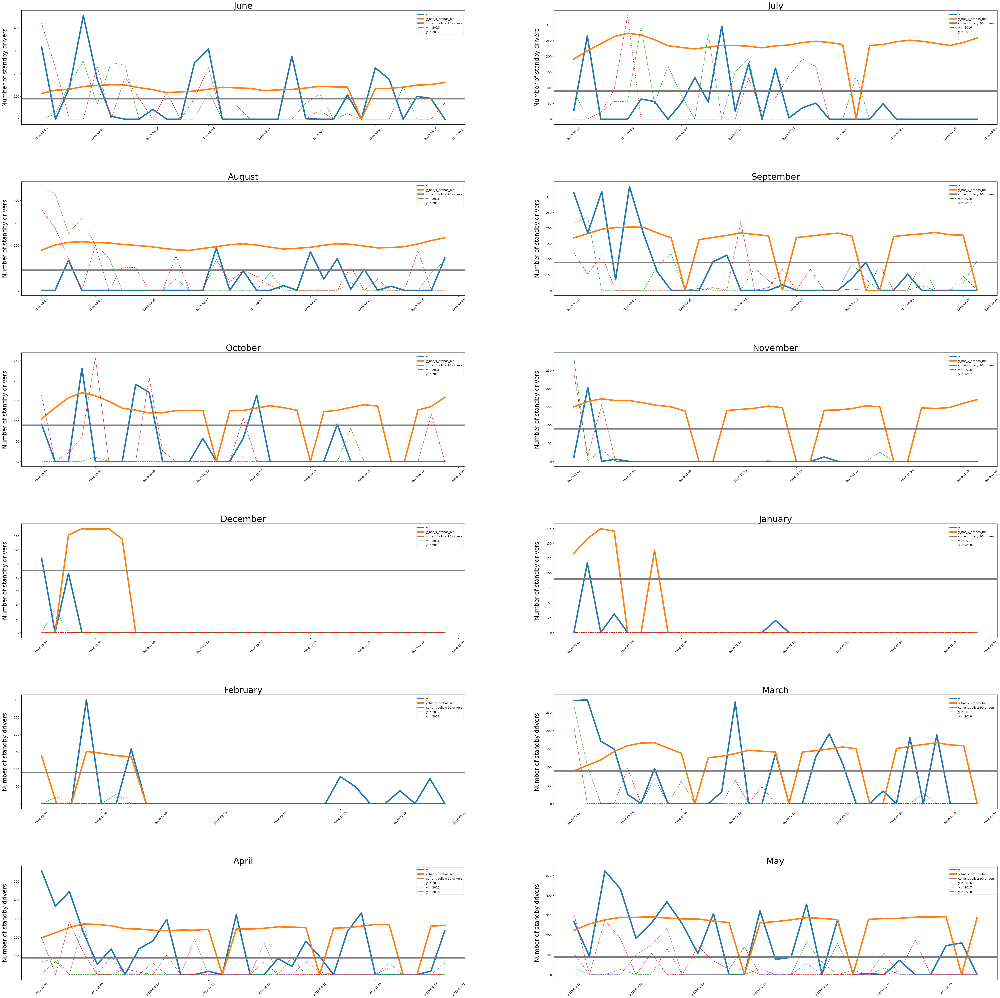

In [32]:
# decision threshold 0.15

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.15)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.630068408168448
Number of additional underpredictions = -3
Number of additional sby drivers required = -2.554859804956422

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -0.462805404107975
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 5.918148585157748
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.180169792717898
Number of additional underpredictions = -1
Number of additional sby drivers required = -44.9644110345813

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -15.433265381657993
Number of additional underpredictions = -1
Num

/tmp/ipykernel_8543/825272837.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["day_of_month"] = previous_years_months["ds"].dt.day
/tmp/ipykernel_8543/825272837.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["month_name"] = previous_years_months["ds"].dt.month_name()
/tmp/ipykernel_8543/825272837.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead




Split for January
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -81.79493326748351
Number of additional underpredictions = 0
Number of additional sby drivers required = -7.0

Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = -72.77777777777779
Number of additional underpredictions = 4
Number of additional sby drivers required = -70.96332175542626

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -11.38252853932513
Number of additional underpredictions = -3
Number of additional sby drivers required = -15.921854800587752

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 1.3316840686874585
Number of additional underpredictions = -7
Number of additional sby drivers required = -34.772386267703325

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 6.047961432830299
Number of additional underpredictions = -6
Numbe

,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,0.630068,-3,-2.554860,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-0.462805,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,5.918149,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-6.180170,-1,-44.964411,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-15.433265,-1,-13.971254,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-36.226772,0,-74.299343,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-79.520436,0,90.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 141.70588027695175, 150.67926813999...","[104.05103830253037, 119.66643386796027, 141.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-81.794933,0,-7.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[133.1416932119767, 157.84775254635736, 174.48...","[133.1416932119767, 157.84775254635736, 174.48...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-72.777778,4,-70.963322,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[137.6335203614402, 0.0, 0.0, 150.677667985080...","[137.6335203614402, 150.11200385972478, 149.29...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season

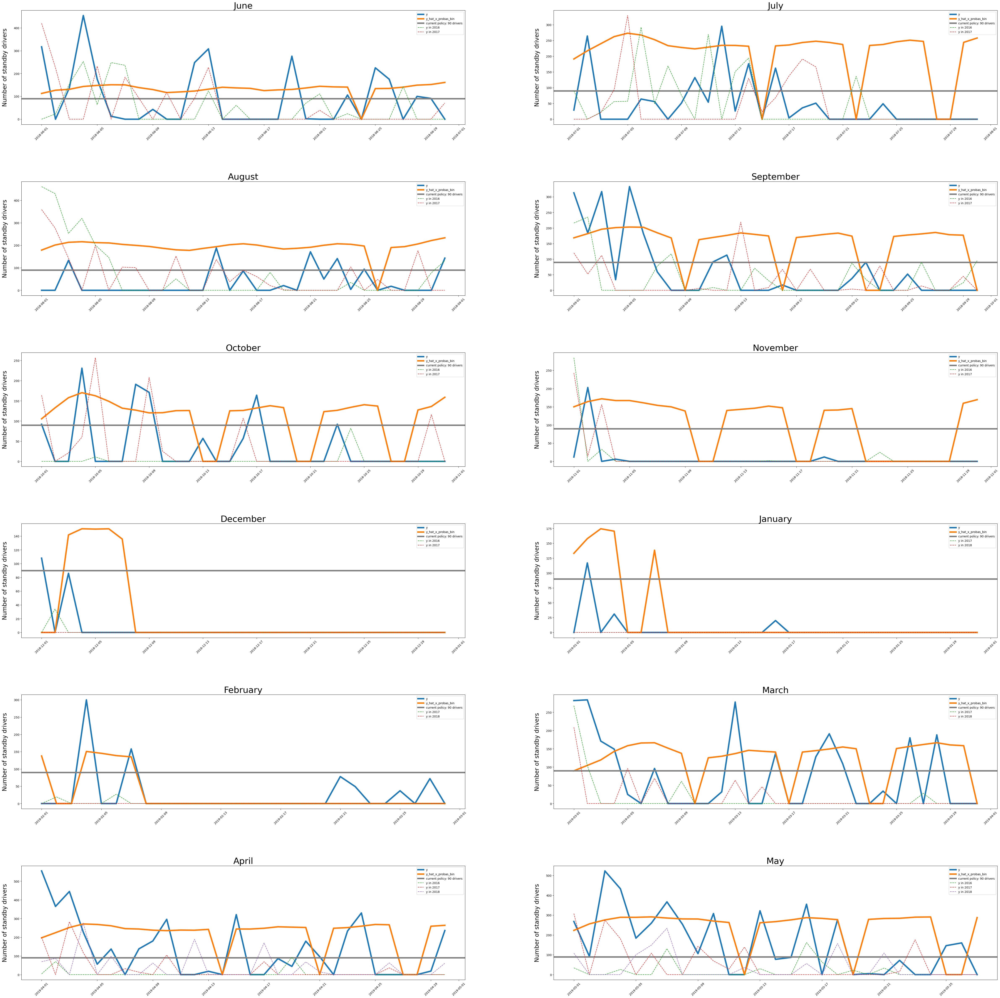

In [33]:
# decision threshold 0.2

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.2)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.857073142944579
Number of additional underpredictions = -2
Number of additional sby drivers required = -4.474373824460741

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -3.6886118557208754
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 2.692342133544848
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -16.180169792717898
Number of additional underpredictions = -1
Number of additional sby drivers required = -44.9644110345813

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -29.2173983654337
Number of additional underpredictions = 0
Num

/tmp/ipykernel_8543/825272837.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["day_of_month"] = previous_years_months["ds"].dt.day
/tmp/ipykernel_8543/825272837.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["month_name"] = previous_years_months["ds"].dt.month_name()
/tmp/ipykernel_8543/825272837.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead




Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = -79.92063492063492
Number of additional underpredictions = 4
Number of additional sby drivers required = -70.96332175542626

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -27.604559599115873
Number of additional underpredictions = -2
Number of additional sby drivers required = 22.401984465540636

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -2.7233127035243427
Number of additional underpredictions = -5
Number of additional sby drivers required = -44.48963376376926

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 2.3407764170793968
Number of additional underpredictions = -5
Number of additional sby drivers required = -53.71093295833056


Mean efficiency loss per month in percent = -35.40764014505857
Mean number of additional underpredictions = -1.3333333333333333
Mean number 

,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-6.857073,-2,-4.474374,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-3.688612,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,2.692342,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-16.180170,-1,-44.964411,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-29.217398,0,-7.448267,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-79.155626,2,-94.099781,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-93.691756,1,79.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-90.885658,1,-1.500000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 157.84775254635736, 174.48687713125946, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-79.920635,4,-70.963322,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 0.0, 0.0, 150.6776679850801, 0.0, 138.70...","[137.6335203614402, 150.11200385972478, 149.29...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season

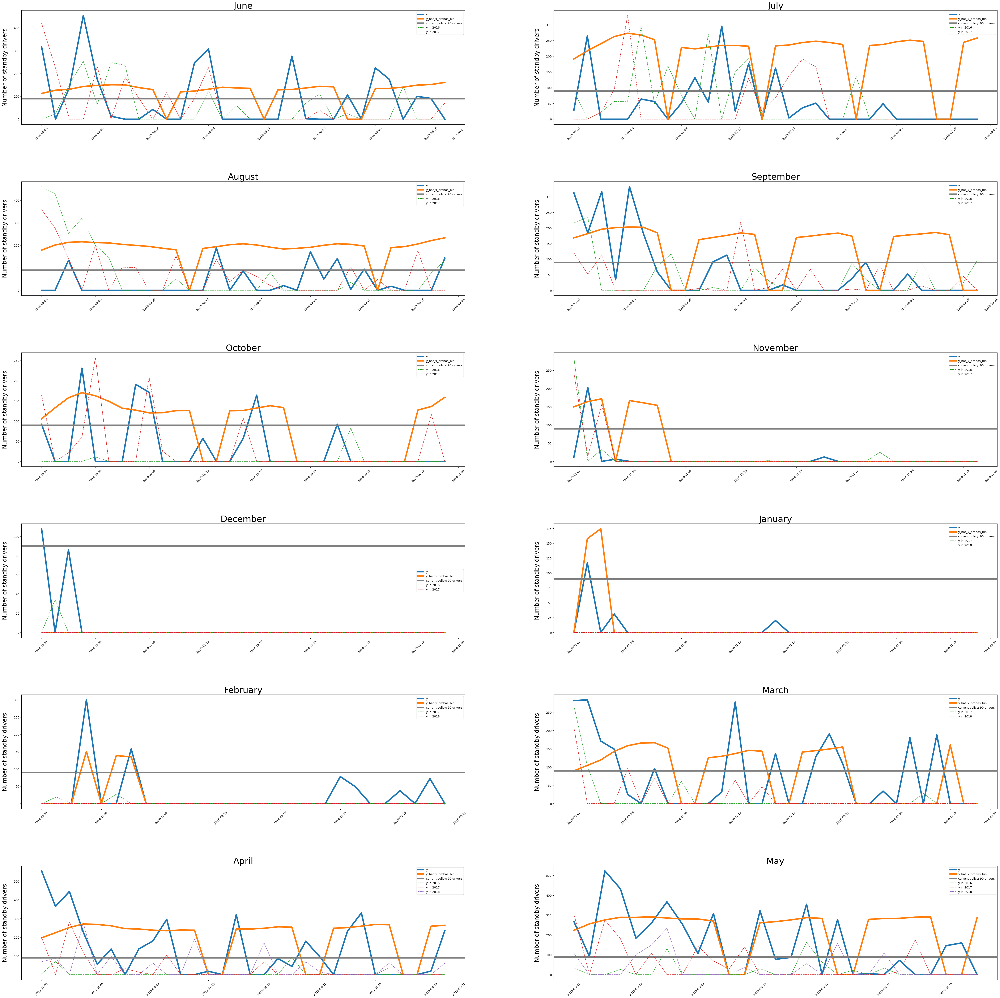

In [39]:
# decision threshold 0.3

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.3)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.857073142944579
Number of additional underpredictions = -2
Number of additional sby drivers required = -4.474373824460741

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -3.6886118557208754
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -1.8492199130518792
Number of additional underpredictions = -4
Number of additional sby drivers required = 2.5

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -31.870509824796365
Number of additional underpredictions = 0
Number of additional sby drivers required = -49.540923743926825

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -32.443204817046606
Number of additional underpredictions = 0


/tmp/ipykernel_8543/825272837.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["day_of_month"] = previous_years_months["ds"].dt.day
/tmp/ipykernel_8543/825272837.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["month_name"] = previous_years_months["ds"].dt.month_name()
/tmp/ipykernel_8543/825272837.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead




Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -12.970883490917466
Number of additional underpredictions = -4
Number of additional sby drivers required = -8.499701796280107

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = -11.535345617019757
Number of additional underpredictions = -4
Number of additional sby drivers required = -58.67660571969445


Mean efficiency loss per month in percent = -40.008757541096884
Mean number of additional underpredictions = -0.8333333333333334
Mean number of additional sby drivers required = -14.592580582815836


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-6.857073,-2,-4.474374,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-3.688612,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,-1.849220,-4,2.500000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-31.870510,0,-49.540924,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-32.443205,0,-7.448267,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-79.155626,2,-94.099781,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-93.691756,1,79.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-83.492063,4,-23.333333,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[137.6335203614402, 150.11200385972478, 149.29...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season_s

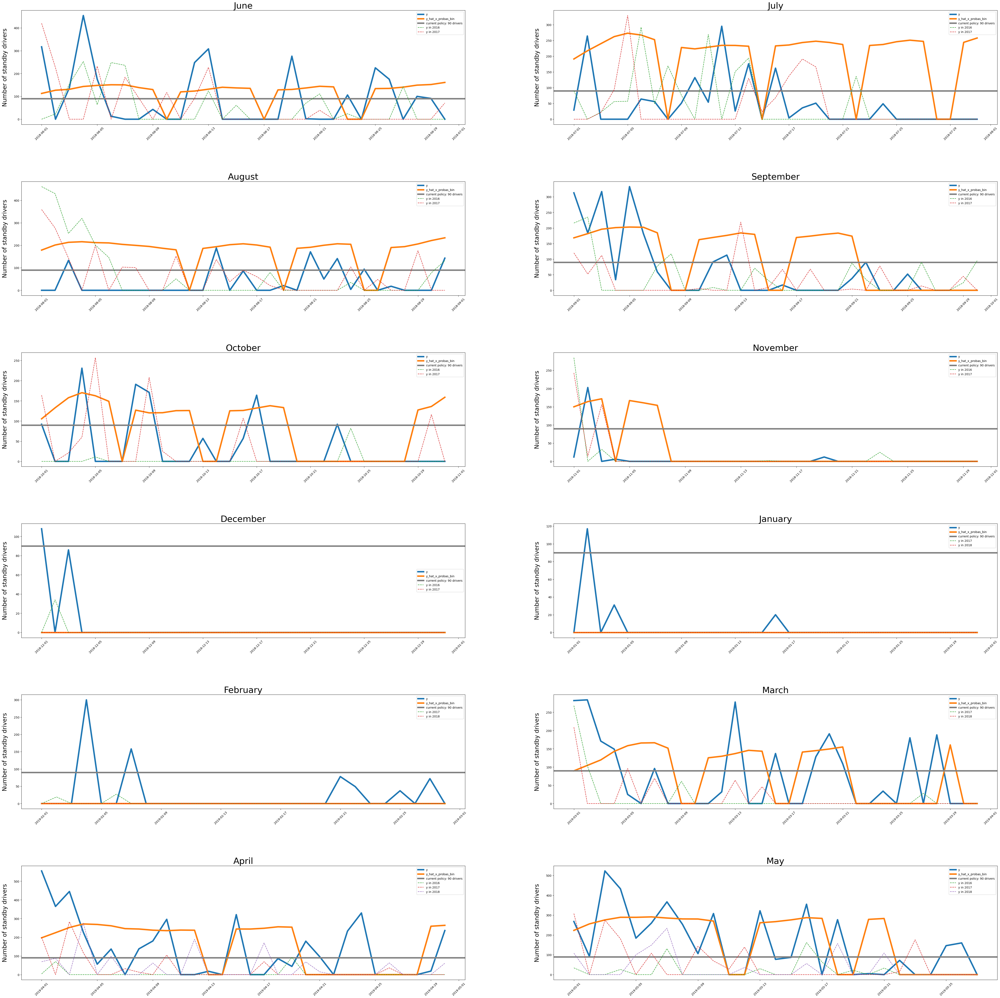

In [43]:
# decision threshold 0.35

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.35)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.857073142944579
Number of additional underpredictions = -2
Number of additional sby drivers required = -4.474373824460741

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -6.914418307333779
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -1.8492199130518792
Number of additional underpredictions = -4
Number of additional sby drivers required = 2.5

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -31.870509824796365
Number of additional underpredictions = 0
Number of additional sby drivers required = -49.540923743926825

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -53.566694405498865
Number of additional underpredictions = 1
N

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -27.604559599115873
Number of additional underpredictions = -2
Number of additional sby drivers required = 22.401984465540636

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -12.970883490917466
Number of additional underpredictions = -4
Number of additional sby drivers required = -8.499701796280107

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = -11.535345617019757
Number of additional underpredictions = -4
Number of additional sby drivers required = -58.67660571969445


Mean efficiency loss per month in percent = -42.037865544435654
Mean number of additional underpredictions = -0.75
Mean number of additional sby drivers required = -10.103702991988092


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-6.857073,-2,-4.474374,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-6.914418,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,-1.849220,-4,2.500000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-31.870510,0,-49.540924,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-53.566694,1,46.418264,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-79.155626,2,-94.099781,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-93.691756,1,79.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-83.492063,4,-23.333333,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[137.6335203614402, 150.11200385972478, 149.29...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season_s

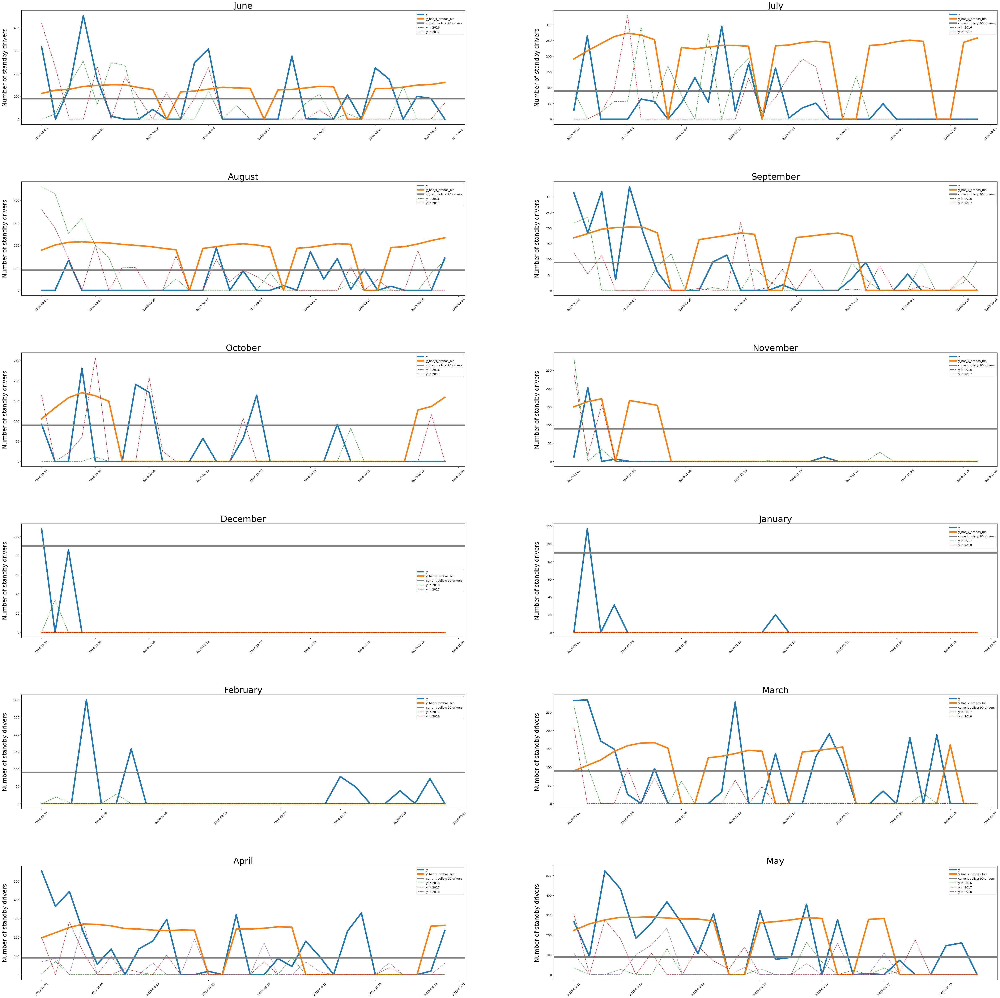

In [40]:
# decision threshold 0.4

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.4)

/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 5.856922067173187
Number of additional underpredictions = -4
Number of additional sby drivers required = -16.439726880043025


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 13.803691758353935
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 11.529391315884538
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 10.495054556012832
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 4.066285786067276
Number of additional underpredictions = -3
Number of additional sby drivers required = -35.043412303146894


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for November
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.5476277711210344
Number of additional underpredictions = 0
Number of additional sby drivers required = -98.45224502806619


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for December
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 1.8730418517048664
Number of additional underpredictions = -1
Number of additional sby drivers required = -18.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for January
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 2.09531914774213
Number of additional underpredictions = -1
Number of additional sby drivers required = -27.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = 4.807501183061062
Number of additional underpredictions = -1
Number of additional sby drivers required = -14.314070568573754


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = 6.746415922383825
Number of additional underpredictions = -7
Number of additional sby drivers required = 3.9511857716848198


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 15.7295999152024
Number of additional underpredictions = -8
Number of additional sby drivers required = -54.98520565845952


/tmp/ipykernel_8543/167320444.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Y_train_df.y = Y_train_df.y.rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()



Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 19.233509434696295
Number of additional underpredictions = -8
Number of additional sby drivers required = -111.56829502642968


Mean efficiency loss per month in percent = 8.065363392450282
Mean number of additional underpredictions = -3.8333333333333335
Mean number of additional sby drivers required = -44.69095750172162


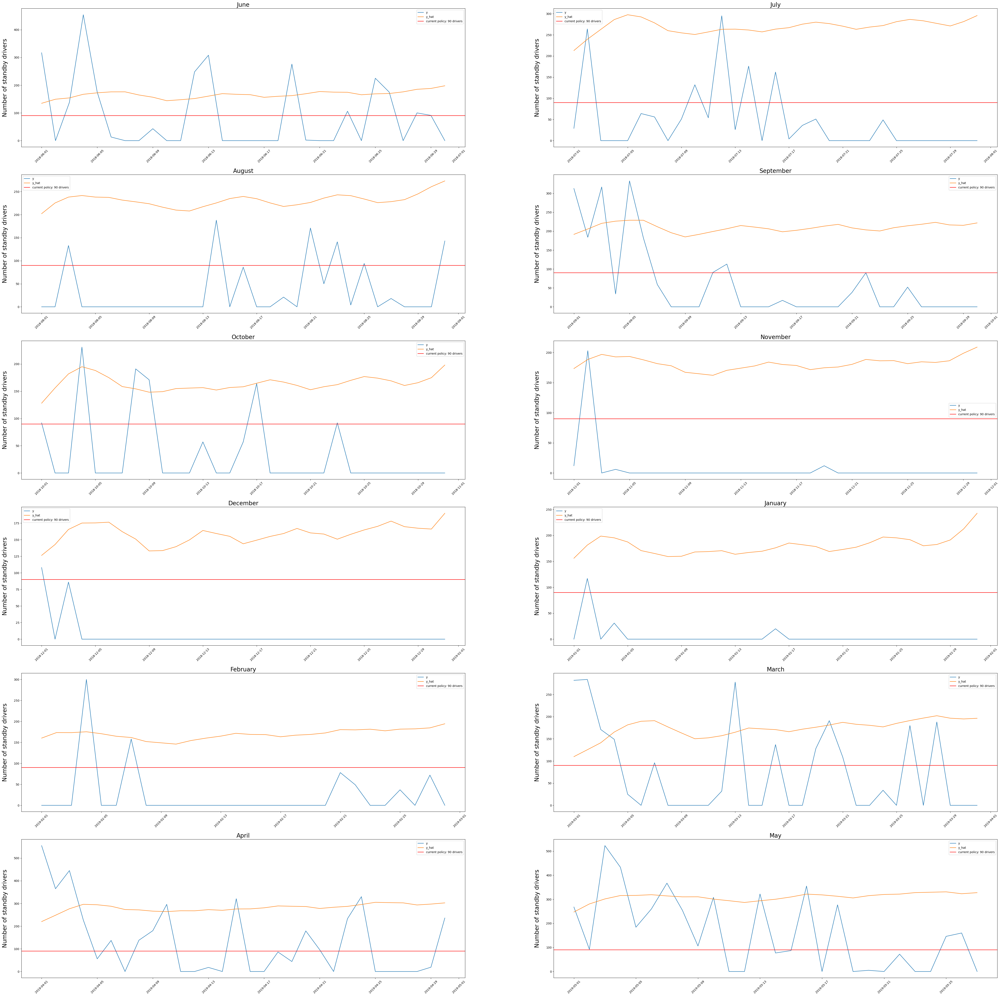

In [34]:
# tbats smoothed bigger interval


forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
tbats_valid_oneday_interval_bigger_df = cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True, interval = 0.8) 

In [35]:
tbats_valid_oneday_interval_bigger = tbats_valid_oneday_interval_bigger_df["y_pred_list"].to_list()

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 2.5235887338398655
Number of additional underpredictions = -4
Number of additional sby drivers required = -16.439726880043025

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 10.577885306741031
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 11.529391315884538
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -4.411767854096524
Number of additional underpredictions = -2
Number of additional sby drivers required = -43.28843805648282

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -8.836940020384336
Number of additional underpredictions = -3


/tmp/ipykernel_8543/825272837.py:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["day_of_month"] = previous_years_months["ds"].dt.day
/tmp/ipykernel_8543/825272837.py:113: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  previous_years_months["month_name"] = previous_years_months["ds"].dt.month_name()
/tmp/ipykernel_8543/825272837.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead




Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -8.762929176414417
Number of additional underpredictions = -6
Number of additional sby drivers required = -6.4990118569293145

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.5478490040791897
Number of additional underpredictions = -7
Number of additional sby drivers required = -58.70160485010817

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 9.956494855103557
Number of additional underpredictions = -7
Number of additional sby drivers required = -100.16392481479264


Mean efficiency loss per month in percent = -19.72294475278902
Mean number of additional underpredictions = -2.9166666666666665
Mean number of additional sby drivers required = -40.42306956695314


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,2.523589,-4,-16.439727,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,10.577885,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,11.529391,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-4.411768,-2,-43.288438,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-8.836940,-3,-35.043412,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-19.452372,0,-98.452245,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-79.239699,0,90.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 165.4284114490558, 175.097523216211...","[126.30836637592972, 142.6633850027554, 165.42...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-81.409326,0,-7.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[155.99862419666243, 181.42307909002525, 198.7...","[155.99862419666243, 181.42307909002525, 198.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-72.697512,3,-66.862814,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[160.21079814314908, 0.0, 0.0, 175.31407056857...","[160.21079814314908, 173.39640933828974, 173.2...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, seaso

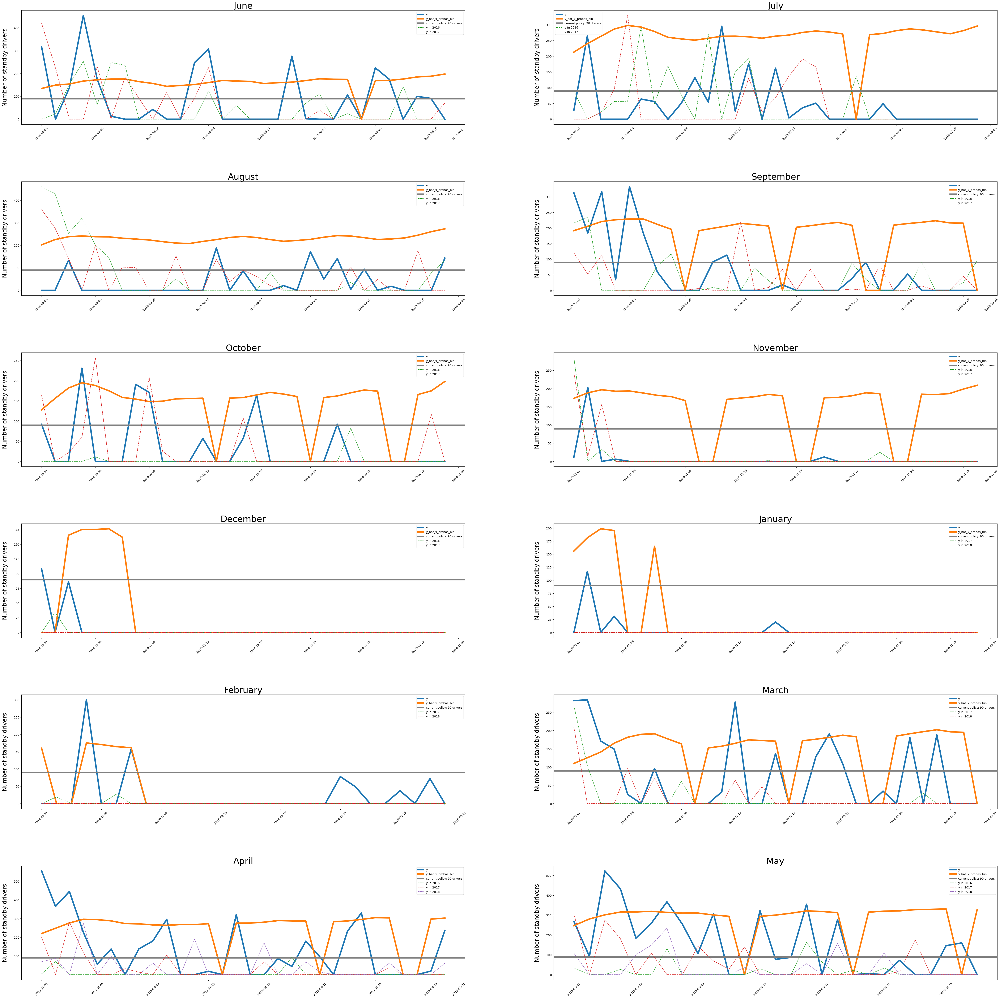

In [36]:
# decision threshold 0.15

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.15)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 2.5235887338398655
Number of additional underpredictions = -4
Number of additional sby drivers required = -16.439726880043025

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 0.9004659519023193
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 8.303584864271638
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -4.411767854096524
Number of additional underpredictions = -2
Number of additional sby drivers required = -43.28843805648282

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -14.114471270105543
Number of additional underpredictions = -2


/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -8.762929176414417
Number of additional underpredictions = -6
Number of additional sby drivers required = -6.4990118569293145

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.5478490040791897
Number of additional underpredictions = -7
Number of additional sby drivers required = -58.70160485010817

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 7.886631995992488
Number of additional underpredictions = -6
Number of additional sby drivers required = -92.84941465018605


Mean efficiency loss per month in percent = -22.799385301284897
Mean number of additional underpredictions = -2.75
Mean number of additional sby drivers required = -39.28831707469815


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,2.523589,-4,-16.439727,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,0.900466,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,8.303585,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-4.411768,-2,-43.288438,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-14.114471,-2,-28.740893,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-36.119039,0,-98.452245,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-79.239699,0,90.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 165.4284114490558, 175.097523216211...","[126.30836637592972, 142.6633850027554, 165.42...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-81.409326,0,-7.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[155.99862419666243, 181.42307909002525, 198.7...","[155.99862419666243, 181.42307909002525, 198.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-72.697512,3,-66.862814,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[160.21079814314908, 0.0, 0.0, 175.31407056857...","[160.21079814314908, 173.39640933828974, 173.2...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season

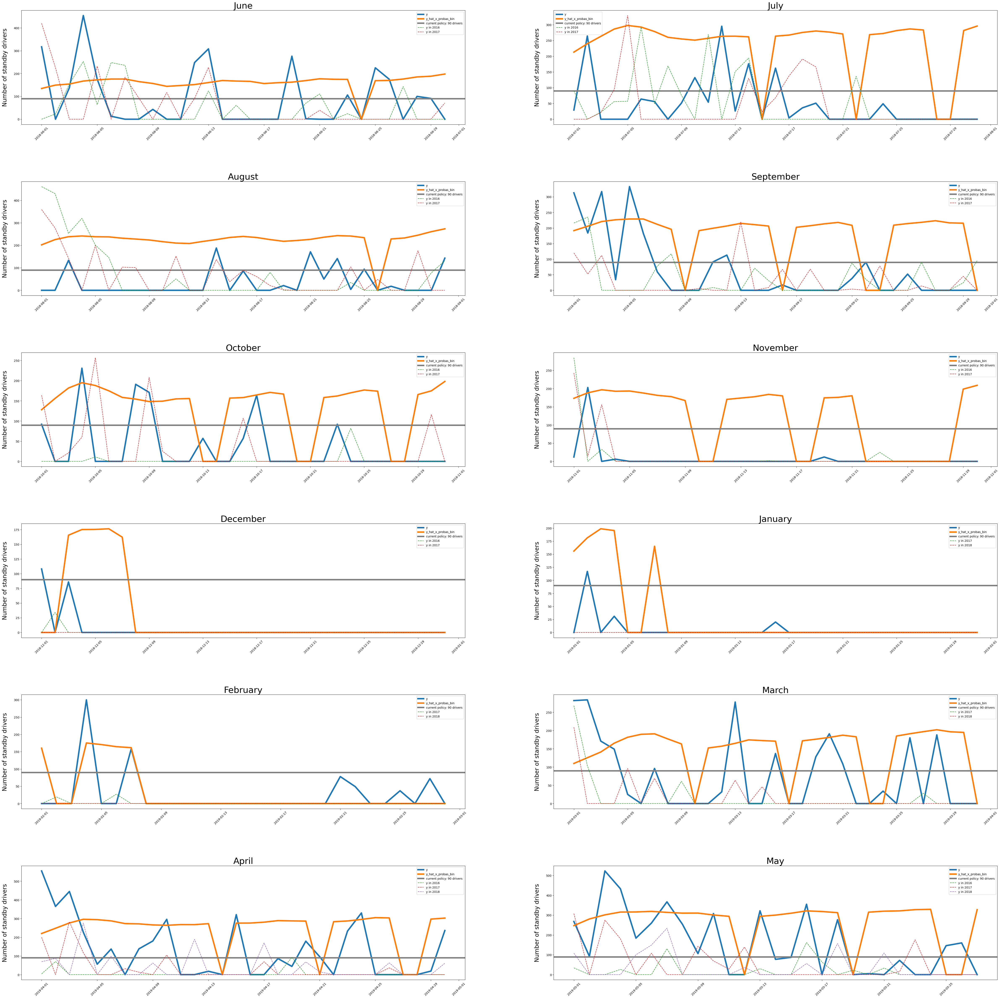

In [37]:
# decision threshold 0.2

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.2)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -5.450113358161175
Number of additional underpredictions = -3
Number of additional sby drivers required = -17.029757226704916

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.325340499710581
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 8.303584864271638
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -14.411767854096524
Number of additional underpredictions = -2
Number of additional sby drivers required = -43.28843805648282

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -14.114471270105543
Number of additional underpredictions = -2

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

Number of additional underpredictions = 3
Number of additional sby drivers required = -66.86281411371475

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -15.853245214551748
Number of additional underpredictions = -5
Number of additional sby drivers required = 0.7508469797748774

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.8162771252688898
Number of additional underpredictions = -5
Number of additional sby drivers required = -63.10124821675079

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 7.886631995992488
Number of additional underpredictions = -6
Number of additional sby drivers required = -92.84941465018605


Mean efficiency loss per month in percent = -26.05818226914532
Mean number of additional underpredictions = -2.4166666666666665
Mean number of additional sby drivers required = -39.09996831441484


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-5.450113,-3,-17.029757,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-2.325340,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,8.303585,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-14.411768,-2,-43.288438,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-14.114471,-2,-28.740893,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-36.119039,0,-98.452245,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-85.691312,0,90.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 165.4284114490558, 0.0, 175.2977270...","[126.30836637592972, 142.6633850027554, 165.42...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-81.409326,0,-7.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[155.99862419666243, 181.42307909002525, 198.7...","[155.99862419666243, 181.42307909002525, 198.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-72.697512,3,-66.862814,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[160.21079814314908, 0.0, 0.0, 175.31407056857...","[160.21079814314908, 173.39640933828974, 173.2...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, sea

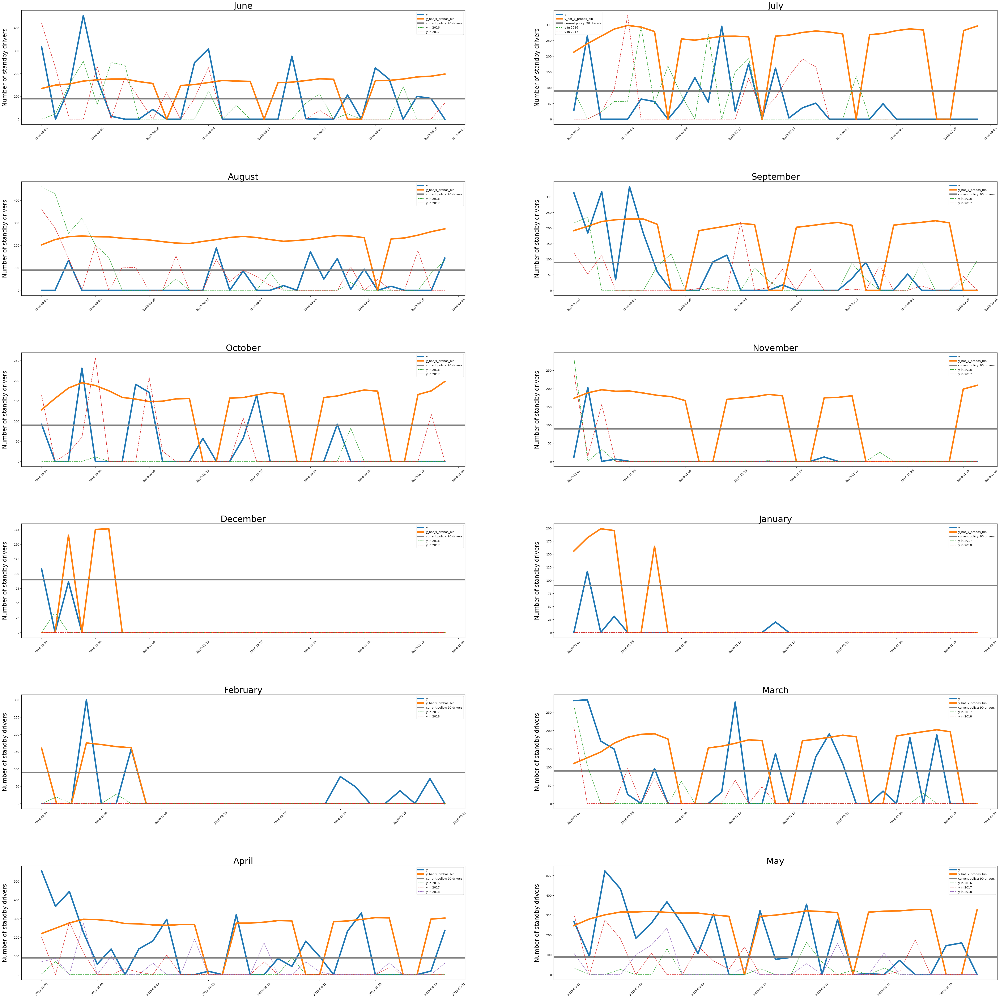

In [38]:
# decision threshold 0.25

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.25)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -5.450113358161175
Number of additional underpredictions = -3
Number of additional sby drivers required = -17.029757226704916

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.325340499710581
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 0.2330149435950588
Number of additional underpredictions = -4
Number of additional sby drivers required = 2.5

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -30.269578698308443
Number of additional underpredictions = -1
Number of additional sby drivers required = -48.90703171373569

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -31.638482605750912
Number of additional underpredictions = -1


/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = -83.4920634920635
Number of additional underpredictions = 4
Number of additional sby drivers required = -23.33333333333333

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -25.94541614041698
Number of additional underpredictions = -3
Number of additional sby drivers required = 20.861769873158238

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -11.445775031298389
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.64823608685137

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = -10.223914721818062
Number of additional underpredictions = -4
Number of additional sby drivers required = -77.02830895621283


Mean efficiency loss per month in percent = -39.0262717913867
Mean number of additional underpredictions = -1.1666666666666667
Mean number of

,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-5.450113,-3,-17.029757,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-2.325340,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,0.233015,-4,2.500000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-30.269579,-1,-48.907032,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-31.638483,-1,-17.959381,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-79.119599,2,-102.150748,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-93.691756,1,79.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[126.30836637592972, 142.6633850027554, 165.42...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-83.492063,4,-23.333333,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[160.21079814314908, 173.39640933828974, 173.2...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, seas

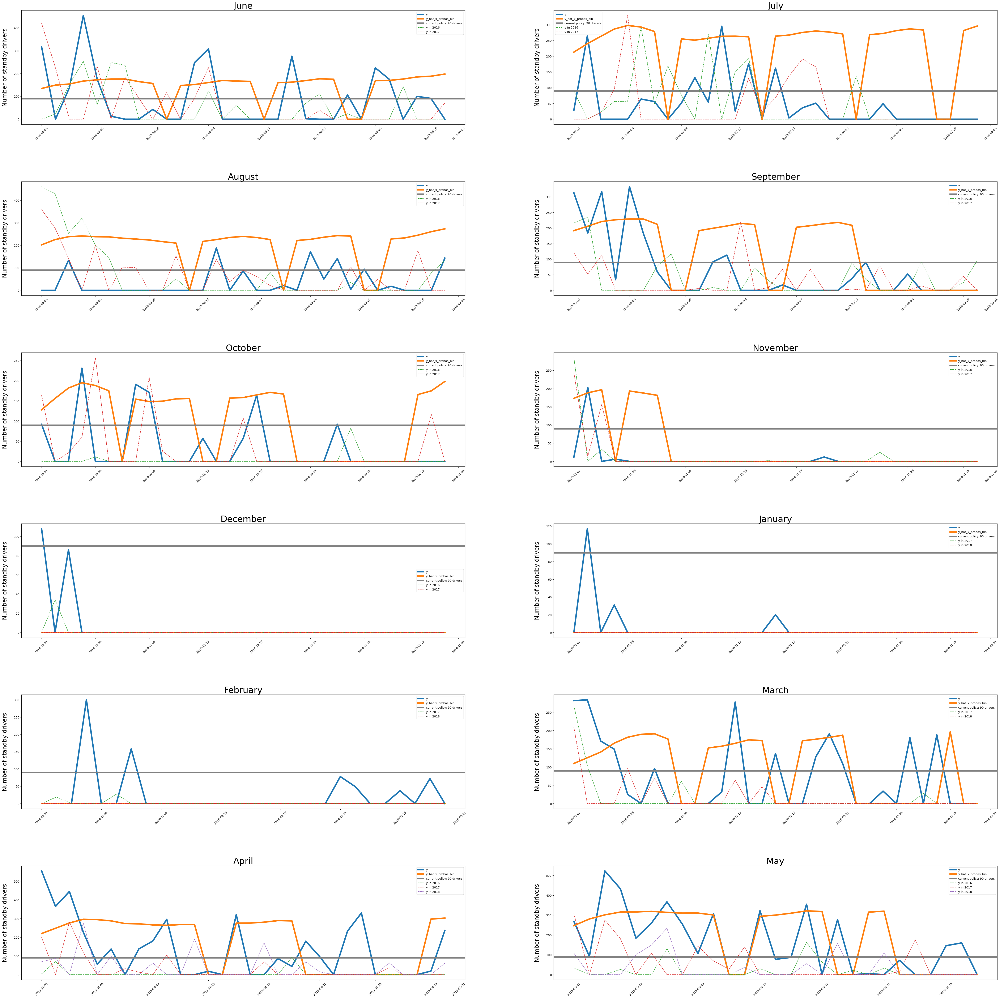

In [41]:
# decision threshold 0.35

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.35)

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -5.450113358161175
Number of additional underpredictions = -3
Number of additional sby drivers required = -17.029757226704916

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -5.551146951323485
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 0.2330149435950588
Number of additional underpredictions = -4
Number of additional sby drivers required = 2.5

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -30.269578698308443
Number of additional underpredictions = -1
Number of additional sby drivers required = -48.90703171373569

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -53.07056217171589
Number of additional underpredictions = 1
Nu

/tmp/ipykernel_8543/825272837.py:84: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["probas"] = probas
/tmp/ipykernel_8543/825272837.py:85: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["y_preds"] = y_hat_x_probas_bin
/tmp/ipykernel_8543/825272837.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide


Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = -83.4920634920635
Number of additional underpredictions = 4
Number of additional sby drivers required = -23.33333333333333

Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -25.94541614041698
Number of additional underpredictions = -3
Number of additional sby drivers required = 20.861769873158238

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -11.445775031298389
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.64823608685137

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = -10.223914721818062
Number of additional underpredictions = -4
Number of additional sby drivers required = -77.02830895621283


Mean efficiency loss per month in percent = -41.081095626184855
Mean number of additional underpredictions = -1.0
Mean number of additional sby drivers required

,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-5.450113,-3,-17.029757,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
1,-5.551147,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
2,0.233015,-4,2.500000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[0.0, 1.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
3,-30.269579,-1,-48.907032,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
4,-53.070562,1,42.882085,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
5,-79.119599,2,-102.150748,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter ...
6,-93.691756,1,79.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[126.30836637592972, 142.6633850027554, 165.42...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 1.0,...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[season_spring, season_summer, season_winter, ...",season_spring season_summer season_winter...
8,-83.492063,4,-23.333333,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[160.21079814314908, 173.39640933828974, 173.2...","[[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[season_spring, season

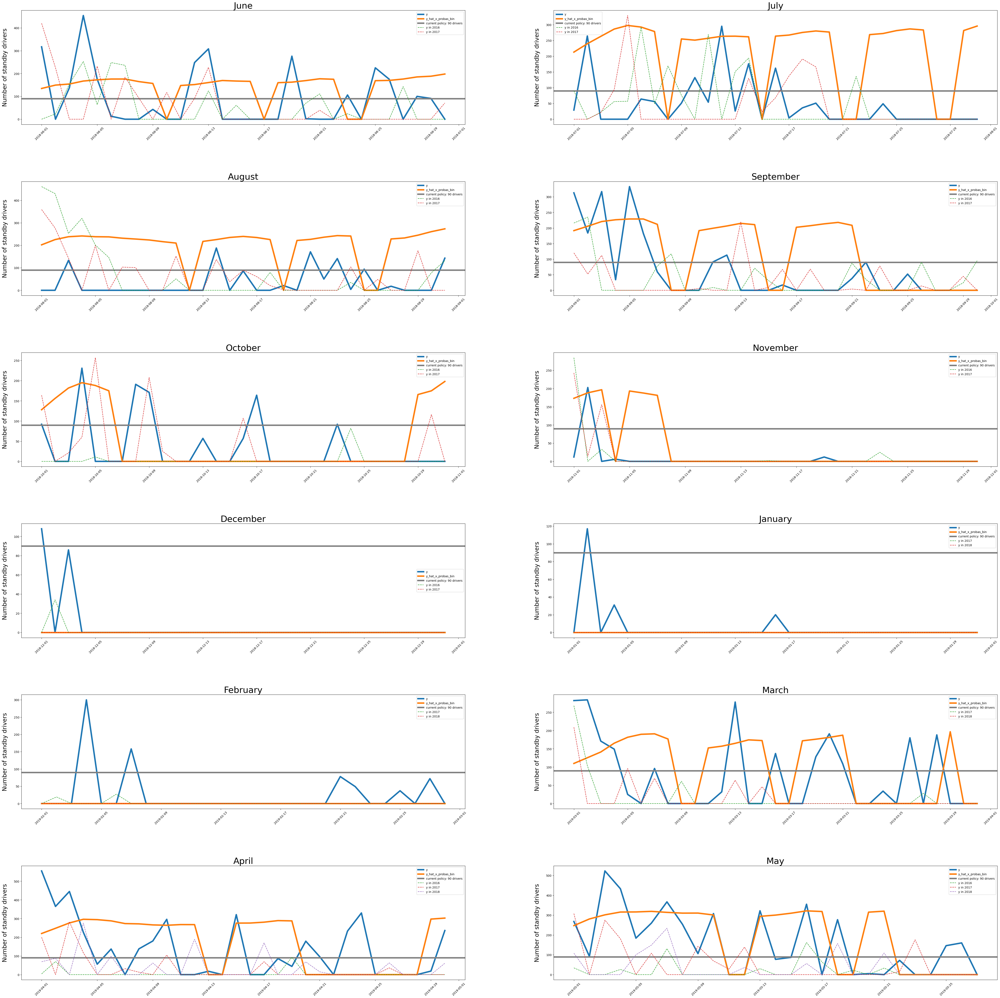

In [42]:
# decision threshold 0.35

combine_clf_reg(selected_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.4)

When inspecting the performance of the above models it becomes apparent that the SVM performs very similar to the EBM when put into the model pipeline. 
However, none of the models above beat my favorite EBM model which had mean values of -36/-2/-28 in the loss metrics.
Furthermore, using SVMs comes at the price of reduced interpretability in comparison to EBMs.

Therefore, I will not further go into the use of SVMs for classification here, and stick to using my EBM classifier.

Next, though already quite a few regressors had been tested before, some more should be examined to see whether they might lead to better performing overall models. 

The story continues in the autoSARIMAX notebook.